In [1]:
import os
os.chdir("../")

overwrite = False
dataset_name = 'nicu'
attr_suffix = '_at'
suffix = '_self' 

# Data

In [2]:
with open('run/settings.py', 'r') as file:
    exec(file.read())
with open('run/data.py', 'r') as file:
    exec(file.read())

Random seed set to 333
using device:  cpu
nicu_at_self

Sample of patients with positive labels:
VitalID
1018    8
5170    8
1835    8
2361    8
2791    8
dtype: int64


Processing descriptions: 100%|██████████| 131/131 [00:27<00:00,  4.72it/s]


After downsampling:
description_succ_inc
High amount of consecutive increases.        10411
Moderate amount of consecutive increases.     9793
Low amount of consecutive increases.          9208
Name: count, dtype: int64
train, test, left:  20588 5882 2942


final distribution of text prediction
description_succ_inc
High amount of consecutive increases.        7288
Moderate amount of consecutive increases.    6855
Low amount of consecutive increases.         6445
Name: count, dtype: int64
description_succ_inc
High amount of consecutive increases.        2082
Moderate amount of consecutive increases.    1958
Low amount of consecutive increases.         1842
Name: count, dtype: int64
description_succ_inc
High amount of consecutive increases.        1041
Moderate amount of consecutive increases.     980
Low amount of consecutive increases.          921
Name: count, dtype: int64
text
Low amount of consecutive increases. Low variability. No events.                                            

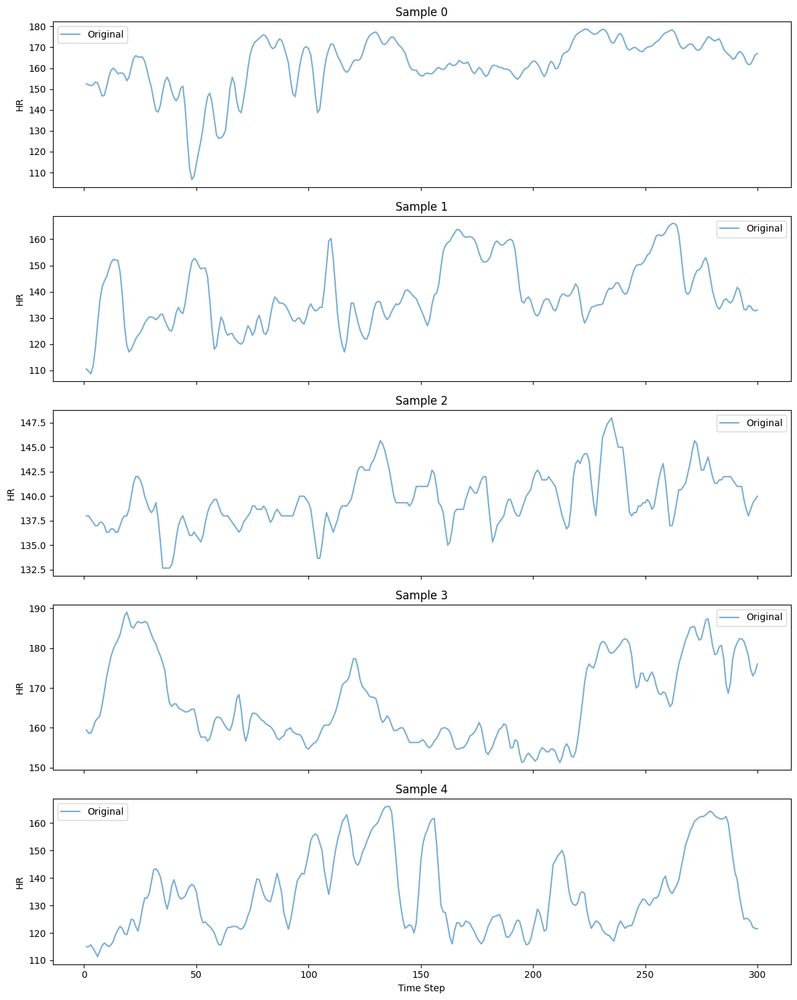

In [4]:
import matplotlib.pyplot as plt

# Make sure original data is preserved before smoothing
original_data = df_train.loc[:, '1':'300'].copy().astype(float)

# Plot comparison for first 5 samples
num_samples = 5
fig, axes = plt.subplots(num_samples, 1, figsize=(12, 3 * num_samples), sharex=True)

for i in range(num_samples):
    axes[i].plot(original_data.columns.astype(int), original_data.iloc[i], label='Original', alpha=0.6)
    axes[i].set_title(f"Sample {i}")
    axes[i].legend()
    axes[i].set_ylabel("HR")

axes[-1].set_xlabel("Time Step")
plt.tight_layout()
plt.show()


In [2]:
with open('run/settings.py', 'r') as file:
    exec(file.read())
with open('run/data.py', 'r') as file:
    exec(file.read())

Random seed set to 333
using device:  cuda
nicu_at_self

Sample of patients with positive labels:
VitalID
5170    8
5749    8
4635    8
1018    8
2361    8
dtype: int64


Processing descriptions: 100%|██████████| 131/131 [02:32<00:00,  1.16s/it]


After downsampling:
description_succ_inc
Low amount of consecutive increases.     11838
High amount of consecutive increases.    10352
Name: count, dtype: int64

Sample of patients with positive labels:
TestID
508     8
707     8
817     8
1903    8
712     7
dtype: int64


Processing descriptions: 100%|██████████| 123/123 [01:53<00:00,  1.08it/s]


After downsampling:
description_succ_inc
Low amount of consecutive increases.     13165
High amount of consecutive increases.    11859
Name: count, dtype: int64
train, test, left:  22190 12512 12512


final distribution of text prediction
description_succ_inc
Low amount of consecutive increases.     11838
High amount of consecutive increases.    10352
Name: count, dtype: int64
description_succ_inc
Low amount of consecutive increases.     6583
High amount of consecutive increases.    5929
Name: count, dtype: int64
description_succ_inc
Low amount of consecutive increases.     6582
High amount of consecutive increases.    5930
Name: count, dtype: int64
nicu_at_self
standardization mean and std:  152.29624515547545 19.00379748955904


# Model (customizable)

In [3]:
# config_dict['alpha_init'] = 10 # close to okay at 0.6
with open('run/model.py', 'r') as file:
    exec(file.read())

nicu_at_self
/sfs/gpfs/tardis/home/jq2uw/llm_nicu_vitalsigns/script/VITAL/results/nicu_at_self
nicu_at_self
Layer (type:depth-idx)                                                 Param #
VITAL                                                                  --
├─TSEncoder: 1-1                                                       --
│    └─LocalNorm: 2-1                                                  --
│    └─PatchCNNTSEncoder: 2-2                                          --
│    │    └─ModuleList: 3-1                                            1,859,424
│    │    └─LayerNorm: 3-2                                             1,536
├─TextEncoder: 1-2                                                     --
│    └─PatchMLPTextEncoder: 2-3                                        --
│    │    └─ModuleList: 3-3                                            5,327,616
├─TSDecoder: 1-3                                                       --
│    └─SelfAttnDecoder: 2-4                             

Epoch [0/2000] 9.03s
	Training Loss: 1339.174645 (clip: 1323.836028, rc: 15.338617, kl: 0.000000)
	Testing Loss: 1363.914370 (clip: 1349.654802, rc: 14.259570, kl: 0.000000)
	Learning Rate: 0.000100000
	alpha: 0.05, beta: 0.0
Epoch [10/2000] 5.42s
	Training Loss: 1328.431387 (clip: 1323.937236, rc: 4.494153, kl: 0.000000)
	Testing Loss: 1355.475837 (clip: 1350.007705, rc: 5.468132, kl: 0.000000)
	Learning Rate: 0.000100000
	alpha: 0.05, beta: 0.0
Epoch [20/2000] 5.35s
	Training Loss: 1328.080865 (clip: 1324.351551, rc: 3.729309, kl: 0.000000)
	Testing Loss: 1353.500732 (clip: 1349.498174, rc: 4.002559, kl: 0.000000)
	Learning Rate: 0.000100000
	alpha: 0.05, beta: 0.0
Epoch [30/2000] 5.47s
	Training Loss: 1327.725943 (clip: 1324.293941, rc: 3.431996, kl: 0.000000)
	Testing Loss: 1353.486443 (clip: 1349.583328, rc: 3.903110, kl: 0.000000)
	Learning Rate: 0.000100000
	alpha: 0.05, beta: 0.0
Epoch [40/2000] 5.40s
	Training Loss: 1327.518485 (clip: 1324.126087, rc: 3.392400, kl: 0.000000)
	

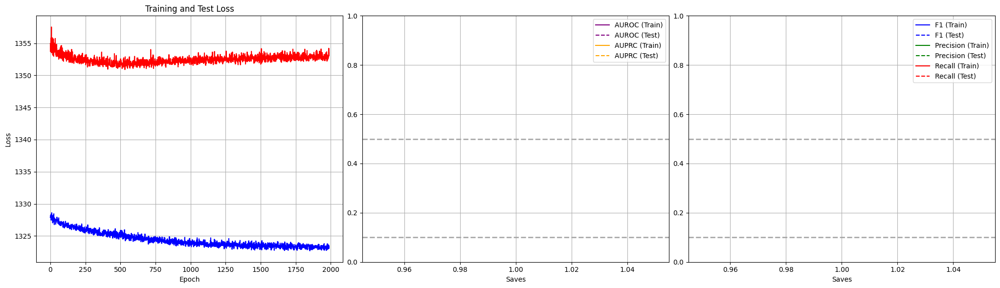

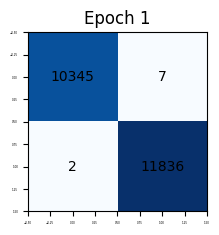

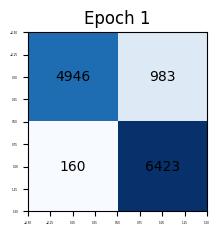

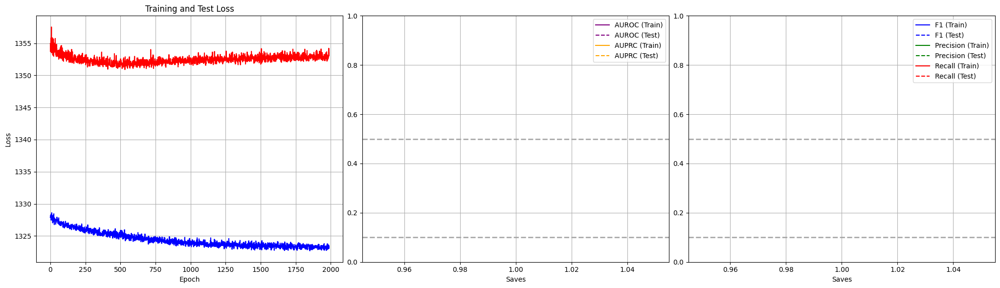

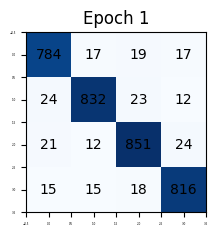

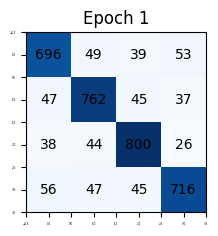

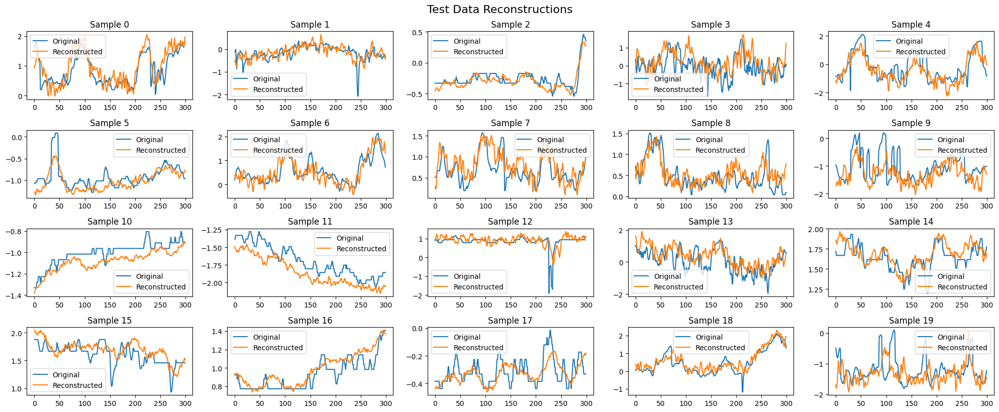

In [4]:
config_dict['alpha_init'] = 5e-2
with open('run/train_2steps.py', 'r') as file:
    exec(file.read())

# Generation

1    Low amount of consecutive increases.
Name: description_succ_inc, dtype: object


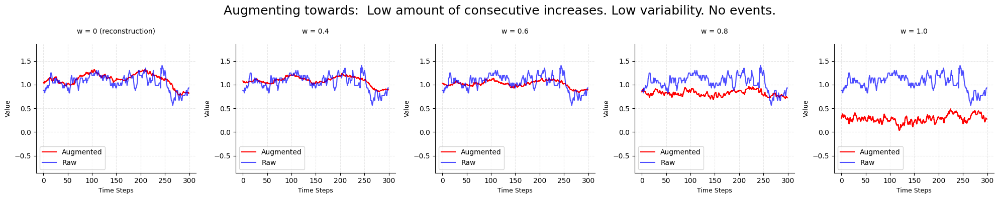

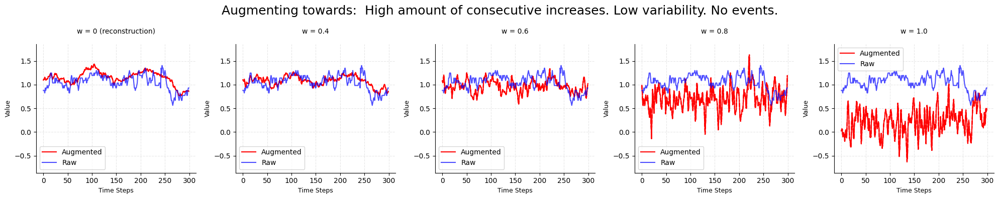

1    High amount of consecutive increases.
Name: description_succ_inc, dtype: object


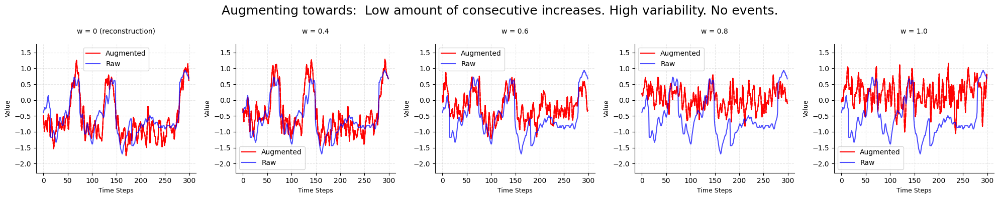

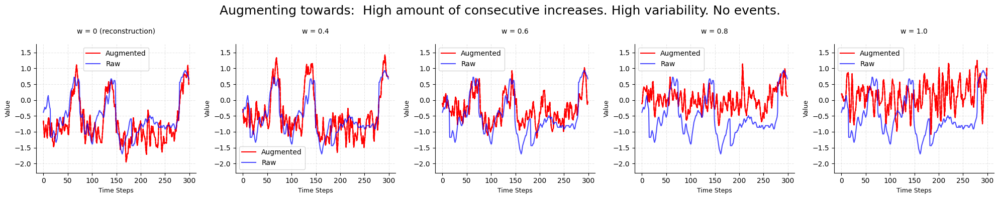

1    Moderate variability.
Name: description_histogram, dtype: object


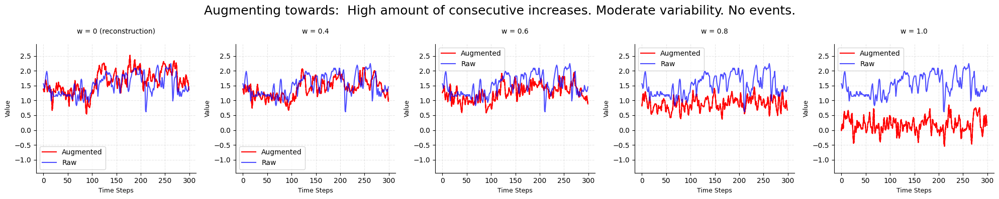

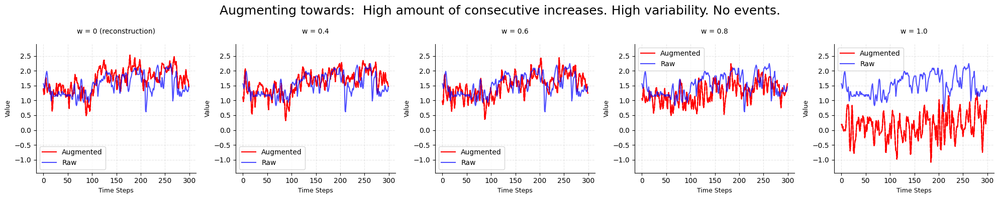

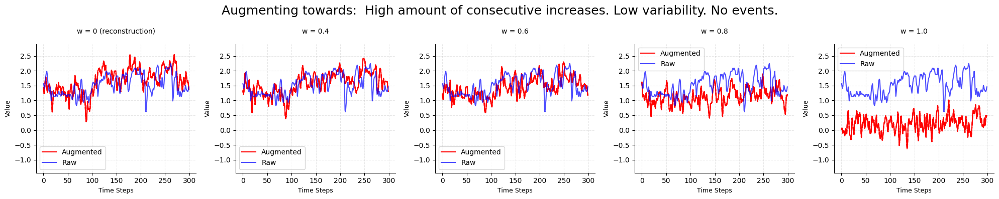

1    High variability.
Name: description_histogram, dtype: object


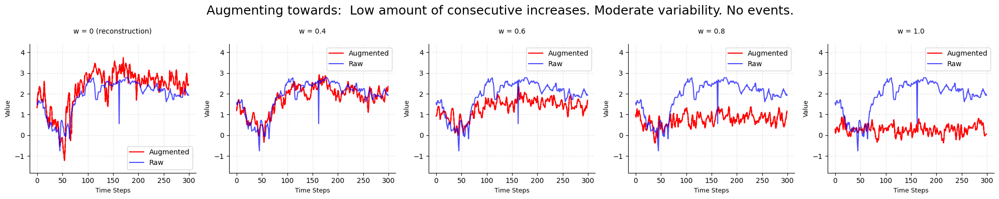

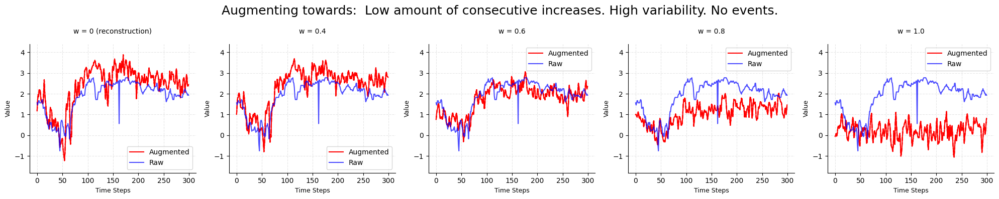

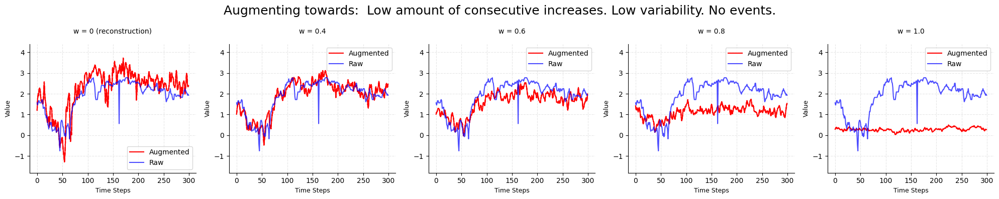

1    Low variability.
Name: description_histogram, dtype: object


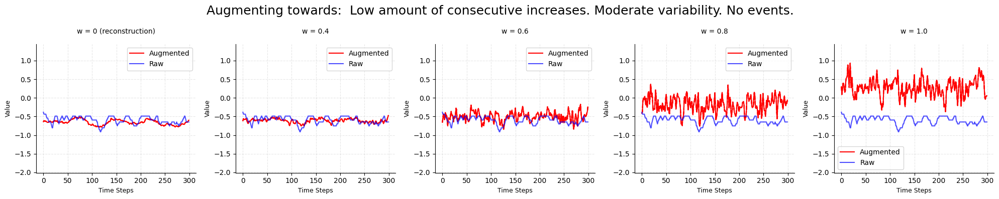

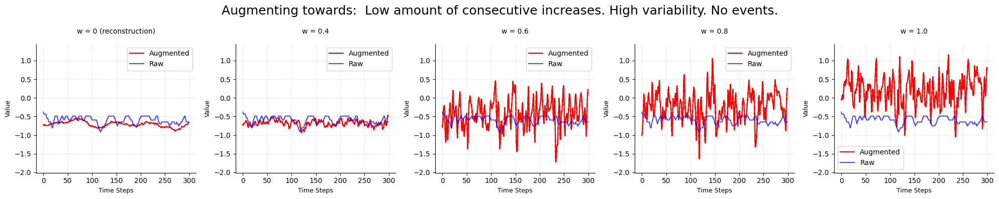

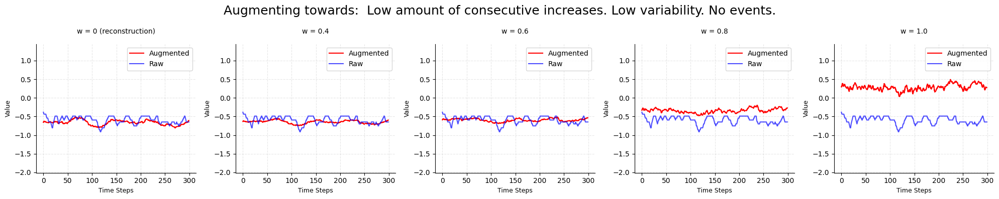

1    No events.
Name: description_ts_event_binary, dtype: object


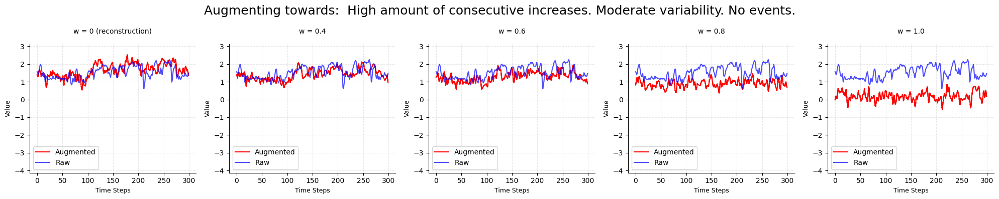

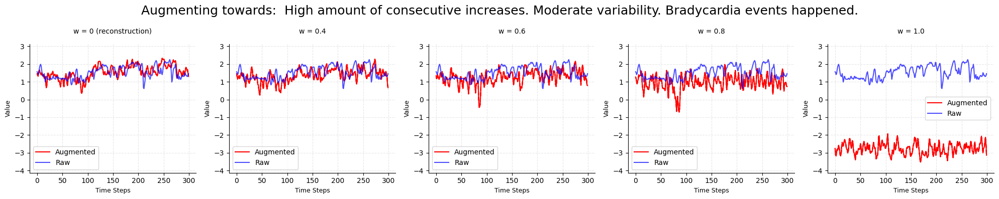

1    Bradycardia events happened.
Name: description_ts_event_binary, dtype: object


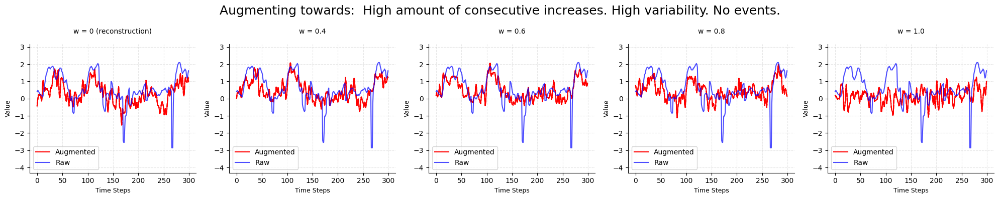

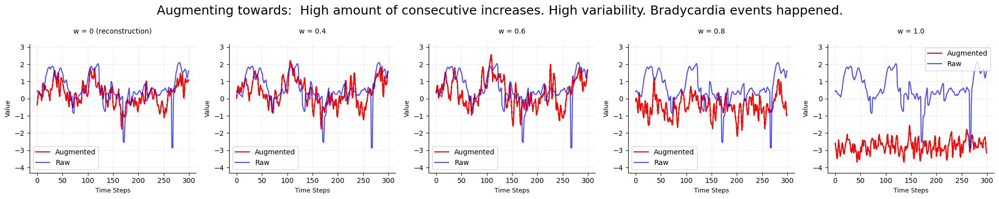

In [5]:
tid=1
viz_generation_conditional(df_left, model, config_dict, tid=tid, sampling=True, b=1, ep=1)

0    High amount of consecutive increases.
Name: description_succ_inc, dtype: object


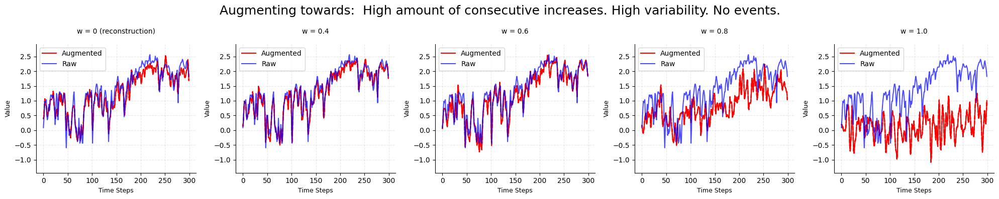

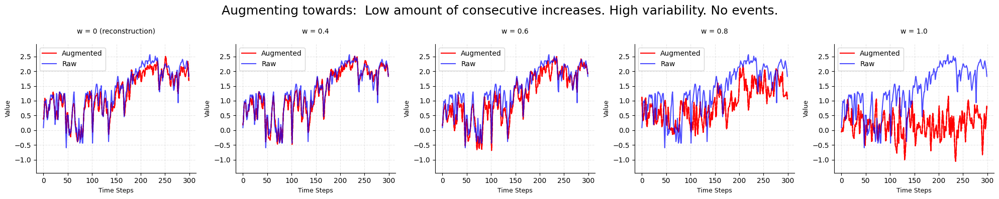

0    Low amount of consecutive increases.
Name: description_succ_inc, dtype: object


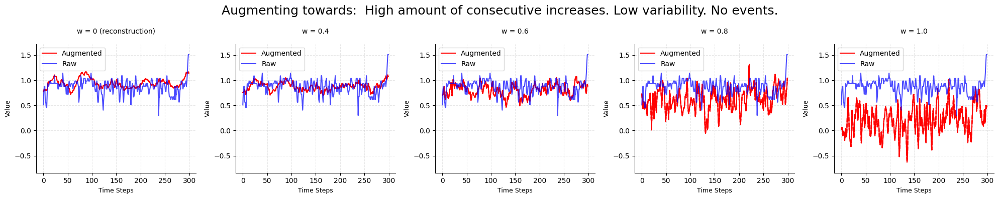

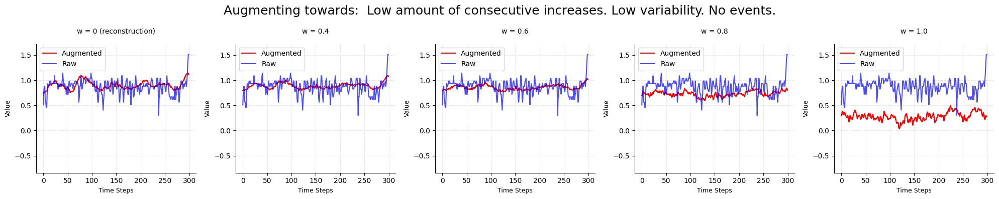

0    High variability.
Name: description_histogram, dtype: object


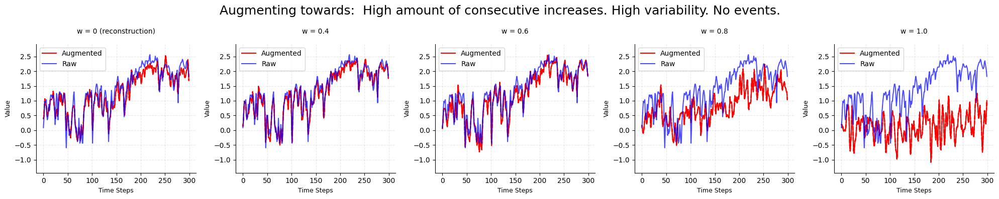

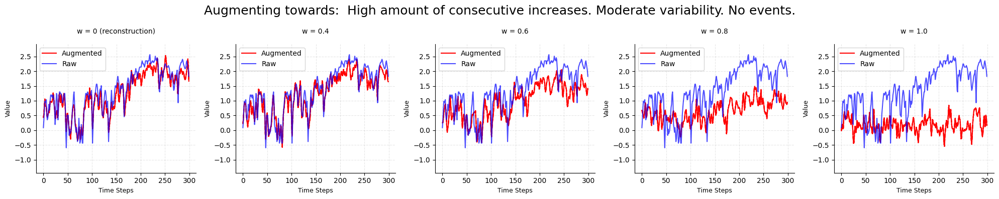

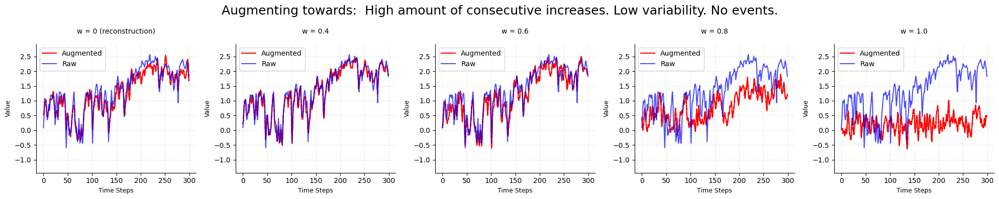

0    Moderate variability.
Name: description_histogram, dtype: object


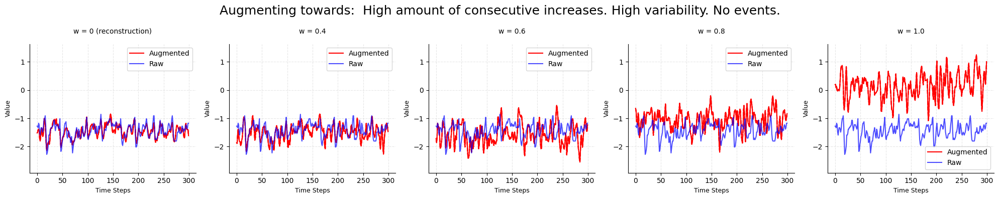

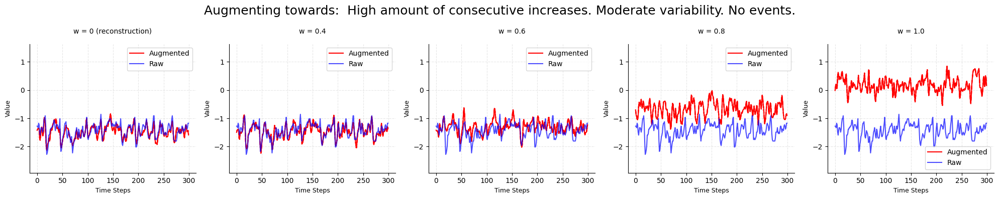

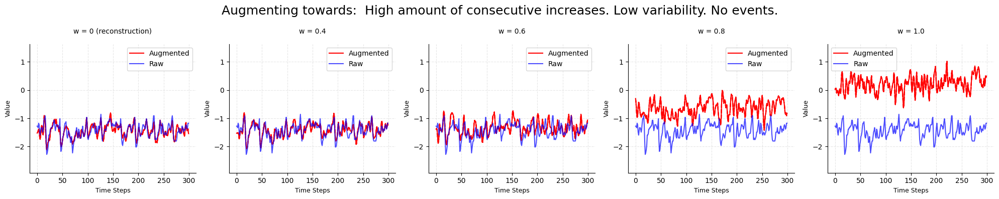

0    Low variability.
Name: description_histogram, dtype: object


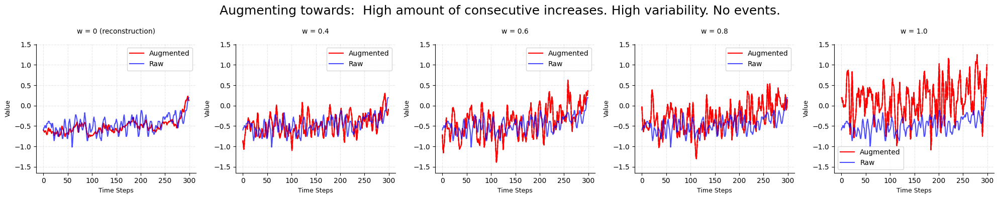

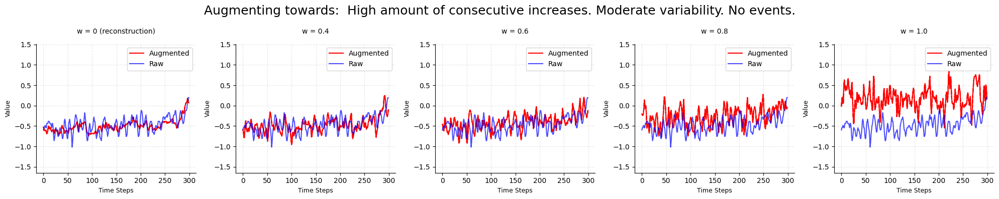

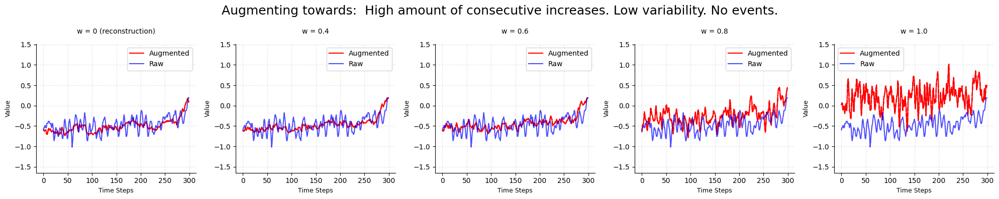

0    No events.
Name: description_ts_event_binary, dtype: object


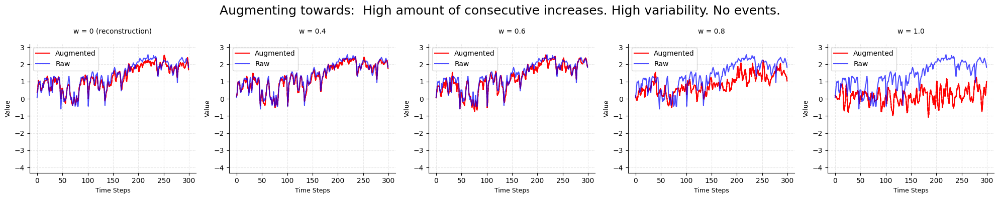

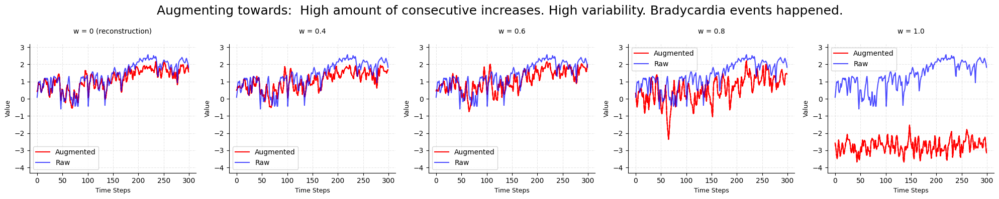

0    Bradycardia events happened.
Name: description_ts_event_binary, dtype: object


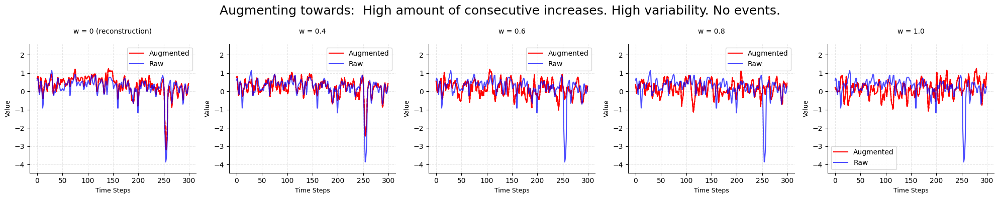

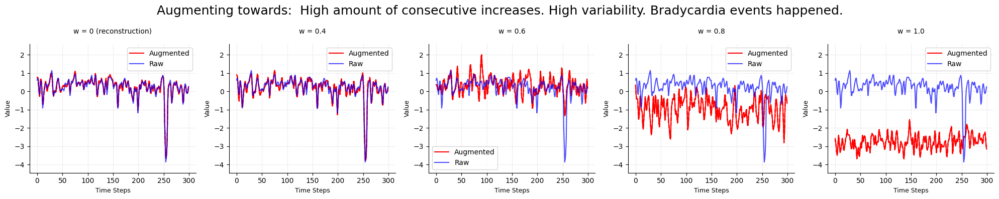

In [6]:
tid=0
# viz_generation_marginal(df_train, model, config_dict, tid=tid)
viz_generation_conditional(df_train, model, config_dict, tid=tid, sampling=True, b=1, ep=1)

description_succ_inc


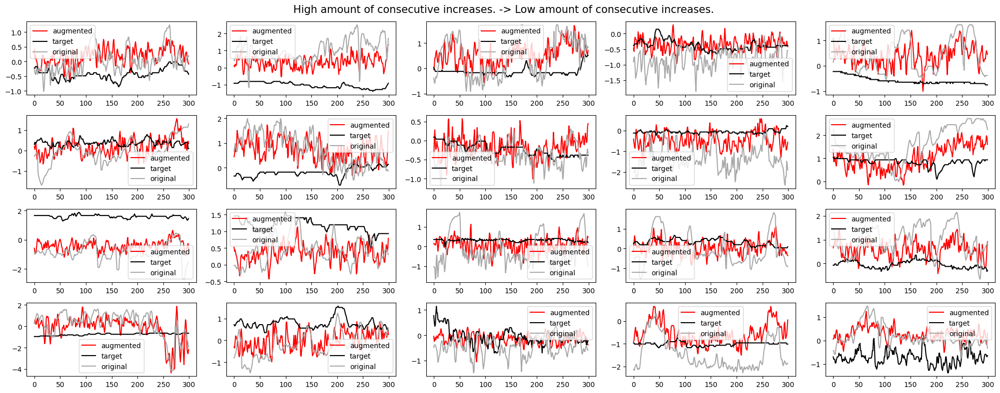

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2709.40it/s]


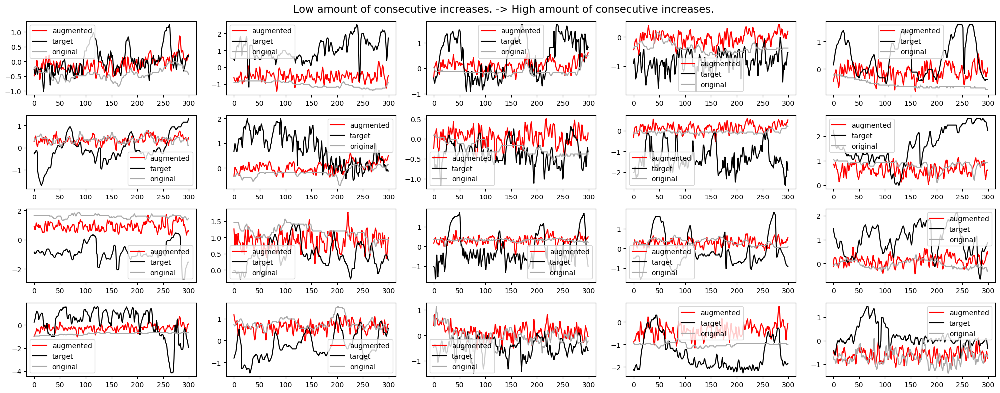

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2692.39it/s]


description_histogram


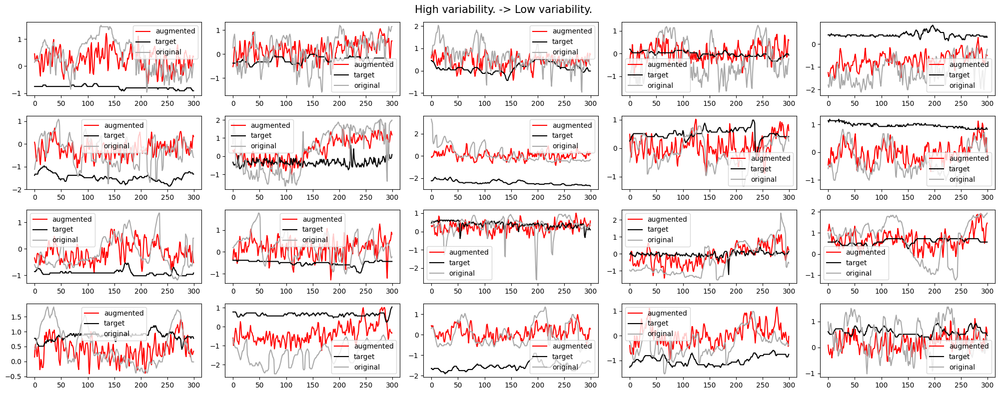

Similarity: 100%|██████████| 40000/40000 [00:15<00:00, 2658.77it/s]


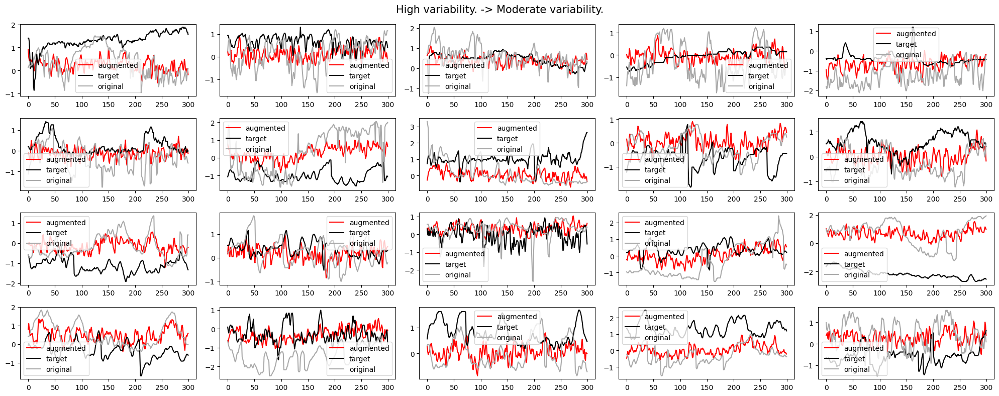

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2712.46it/s]


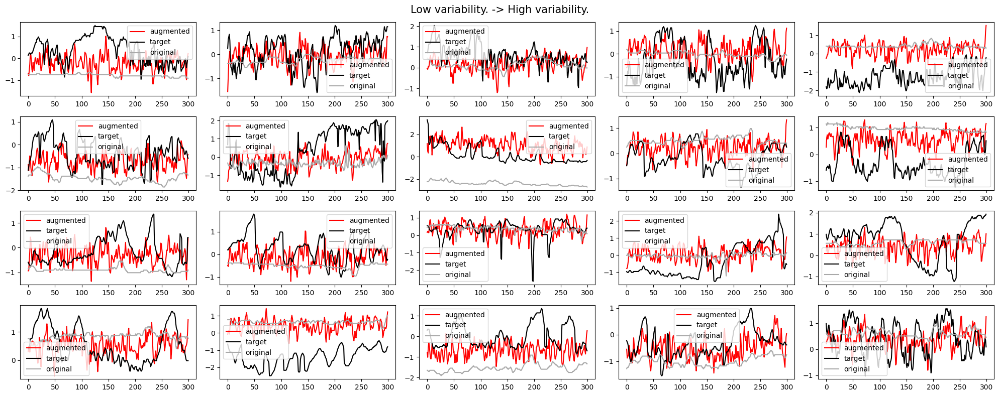

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2699.37it/s]


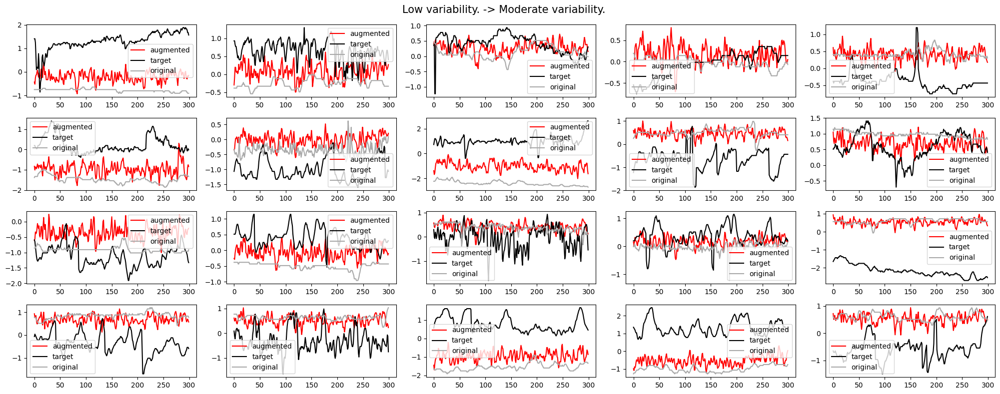

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2720.44it/s]


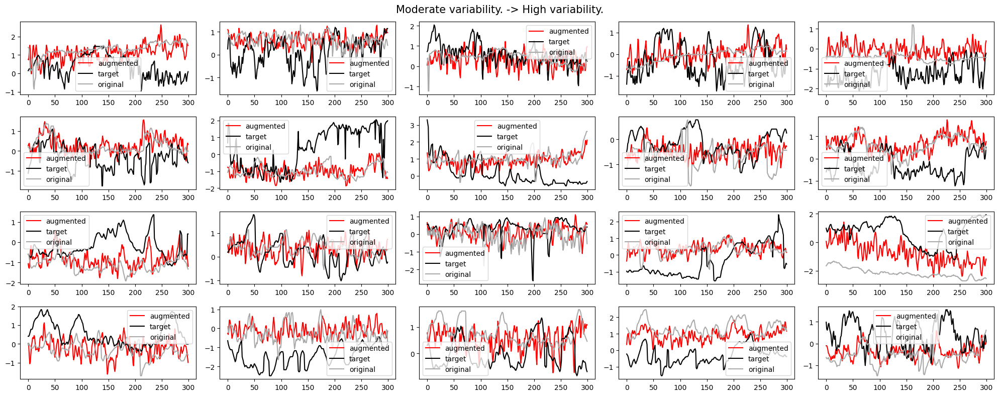

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2684.79it/s]


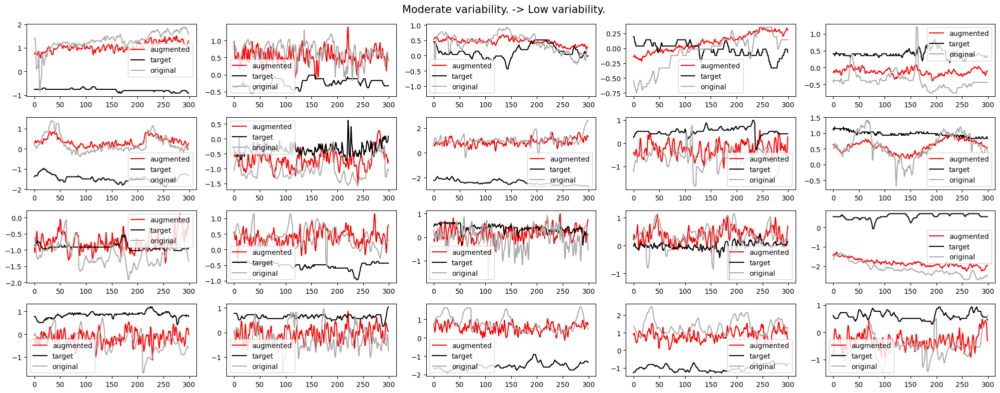

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2721.96it/s]


description_ts_event_binary


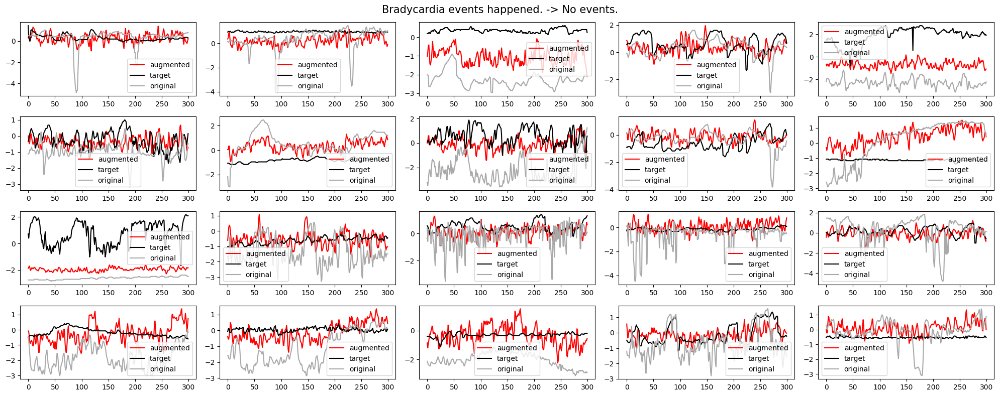

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2687.50it/s]


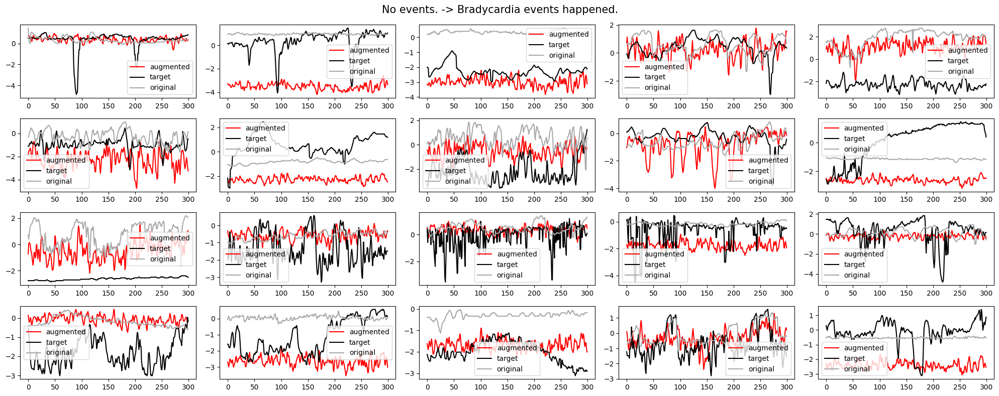

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2712.06it/s]


description_succ_inc


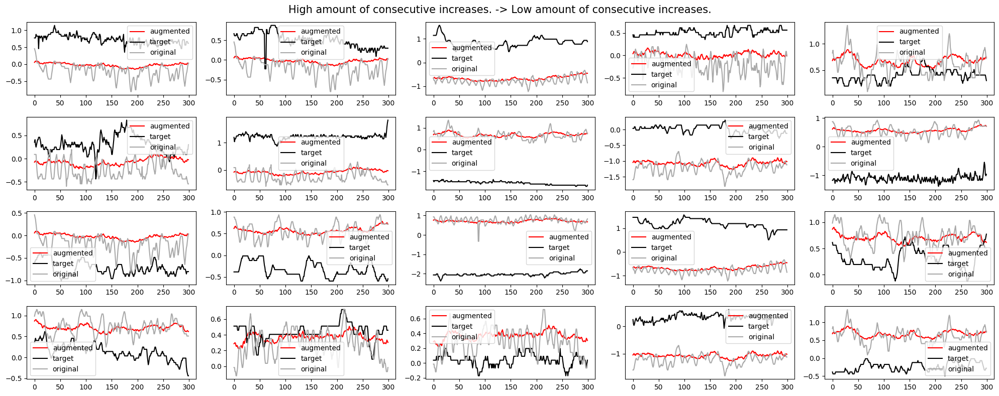

Similarity: 100%|██████████| 40000/40000 [00:15<00:00, 2665.06it/s]


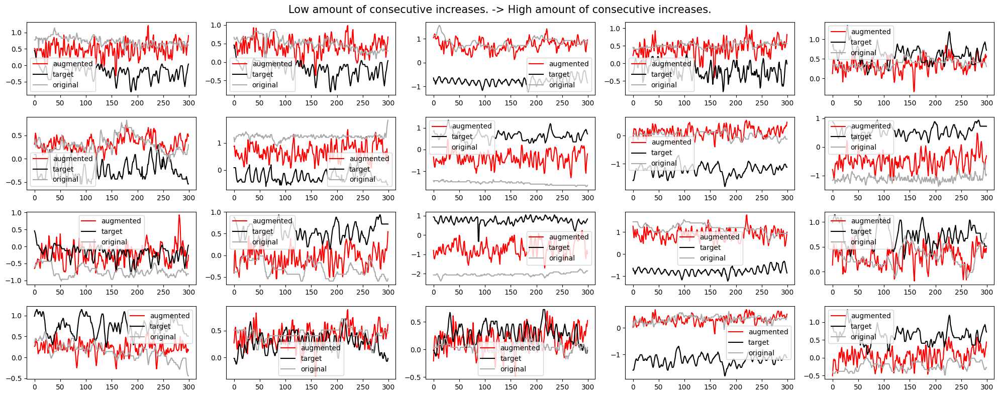

Similarity: 100%|██████████| 40000/40000 [00:15<00:00, 2659.32it/s]


description_histogram


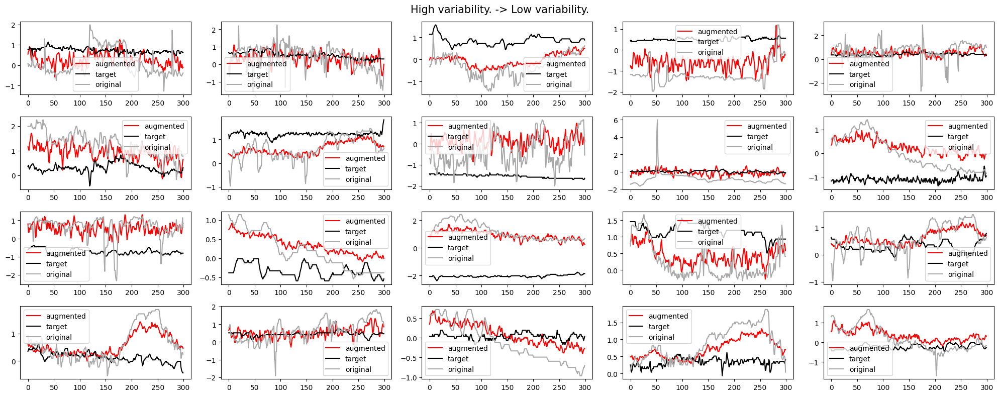

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2738.90it/s]


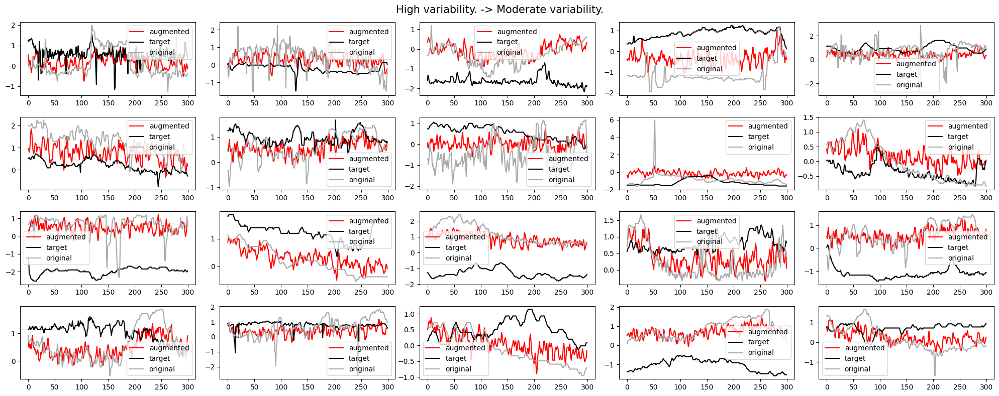

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2708.93it/s]


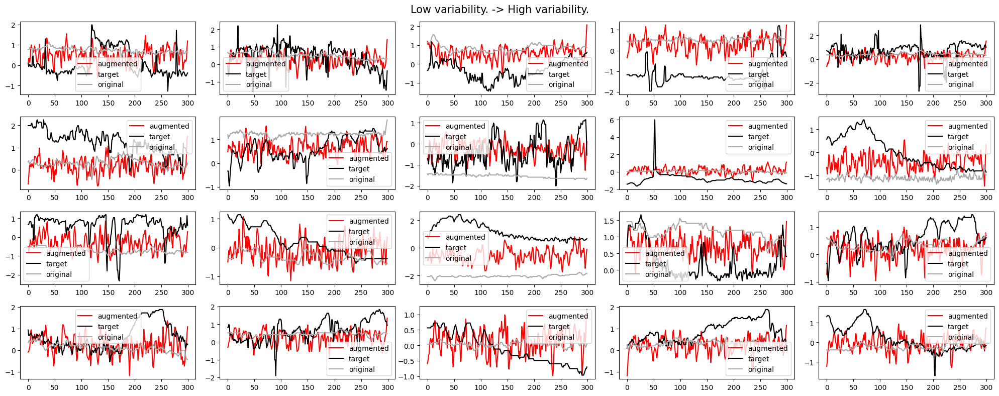

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2695.46it/s]


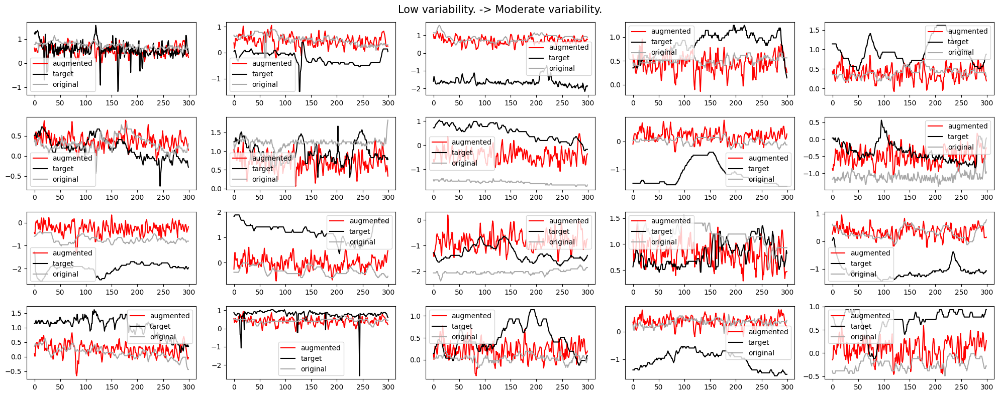

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2716.91it/s]


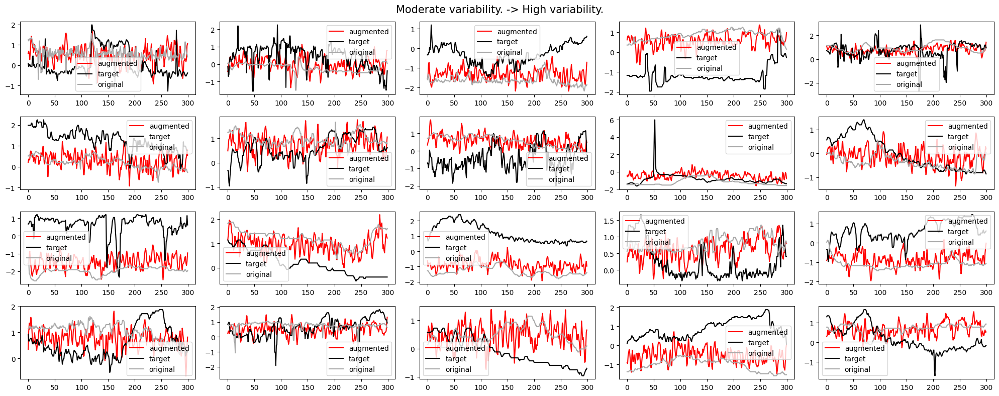

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2683.84it/s]


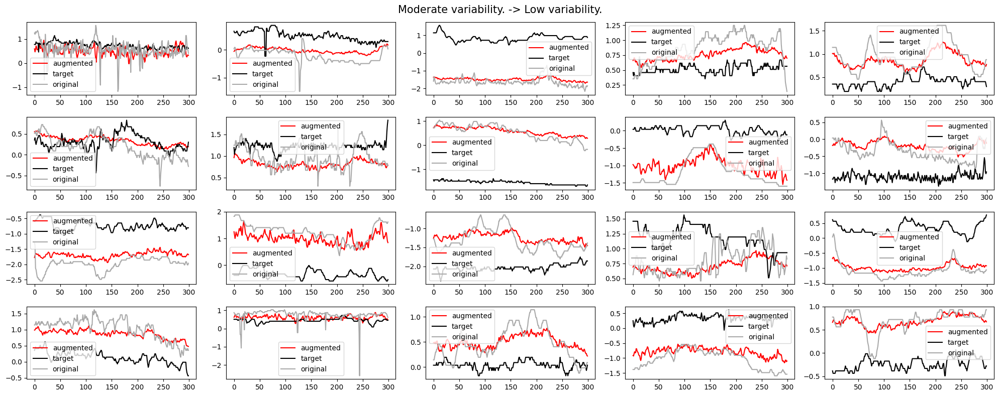

Similarity: 100%|██████████| 40000/40000 [00:15<00:00, 2657.58it/s]


description_ts_event_binary


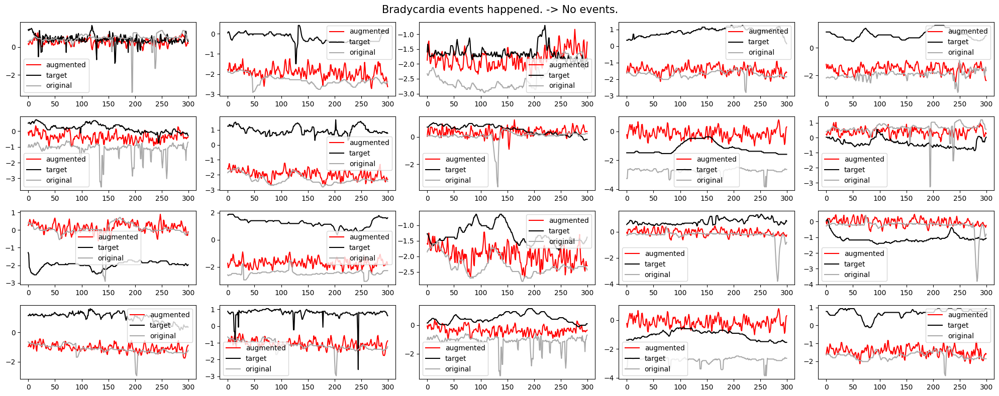

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2674.94it/s]


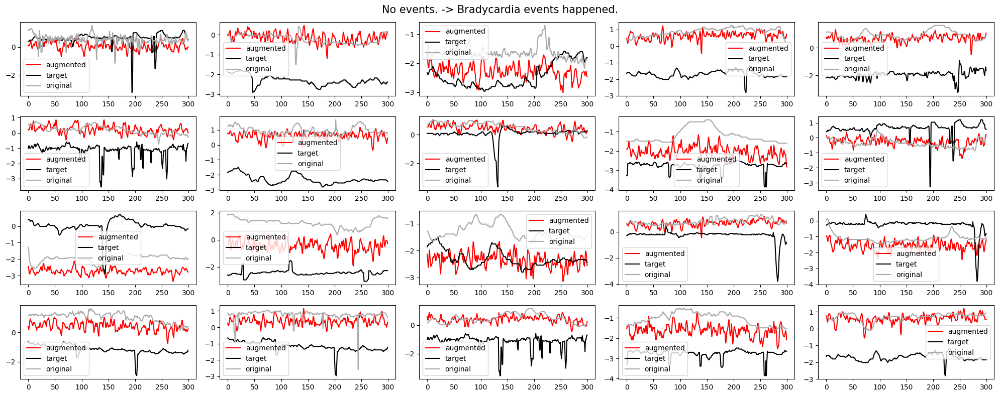

Similarity: 100%|██████████| 40000/40000 [00:14<00:00, 2736.34it/s]


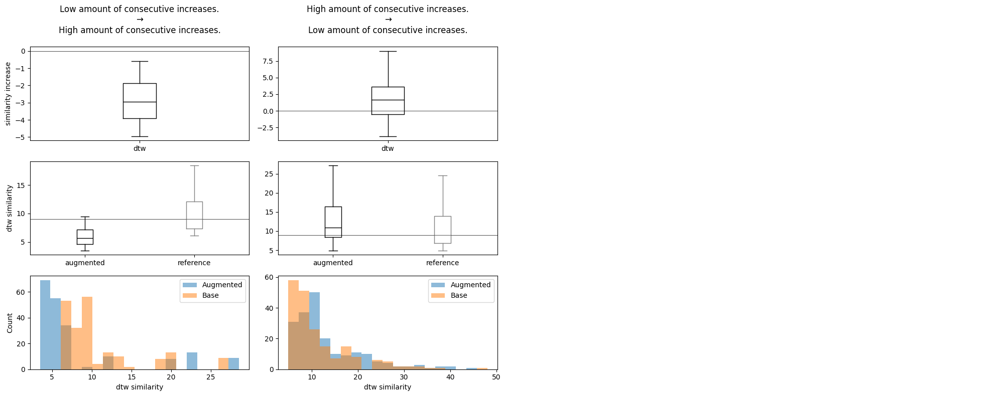

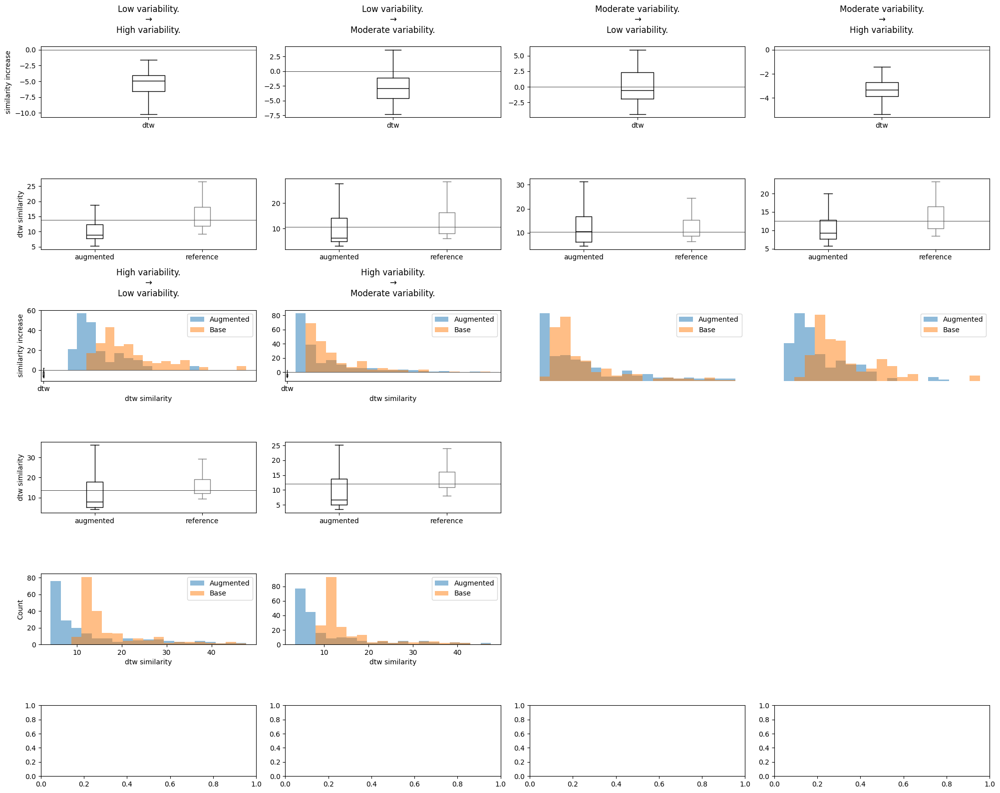

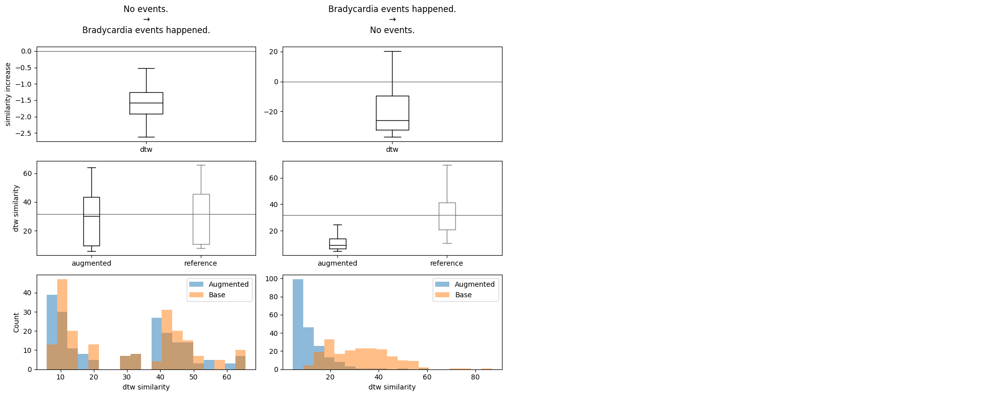

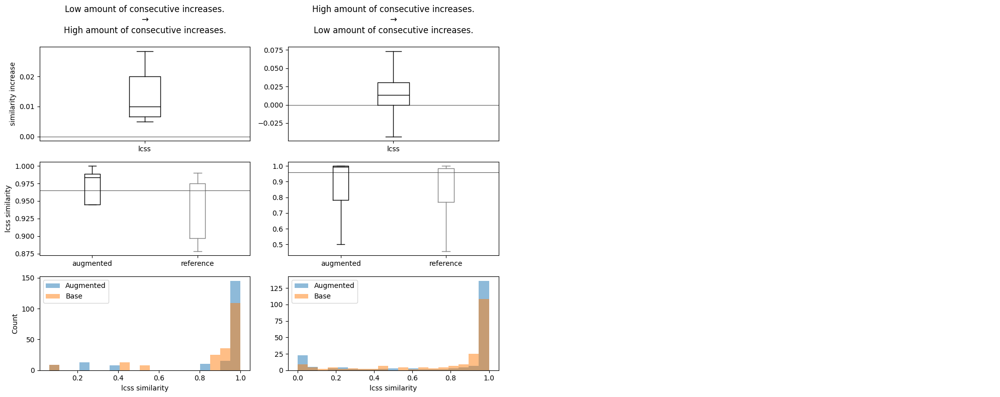

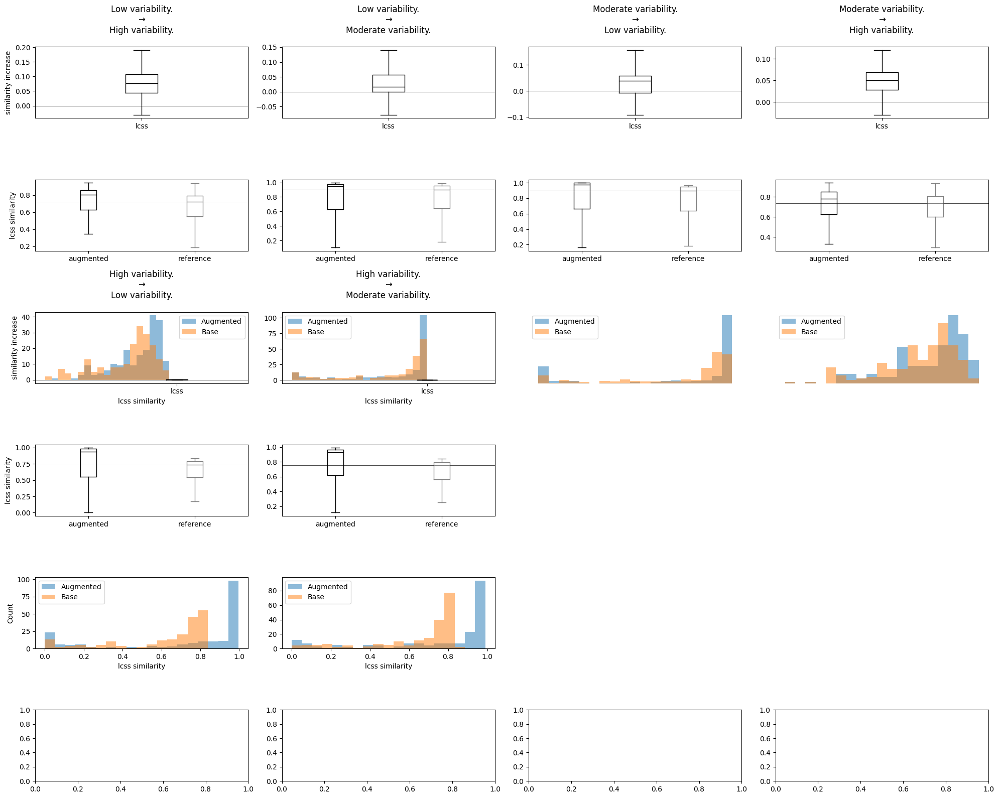

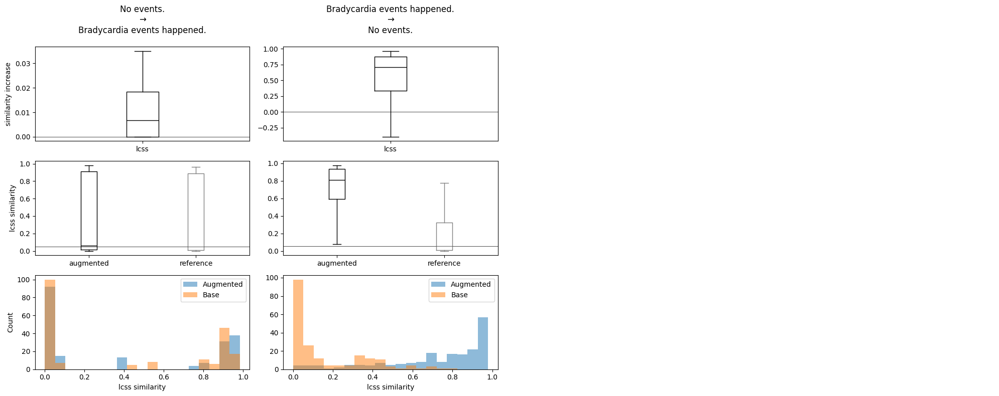

--------------------------------------------------------------------------------


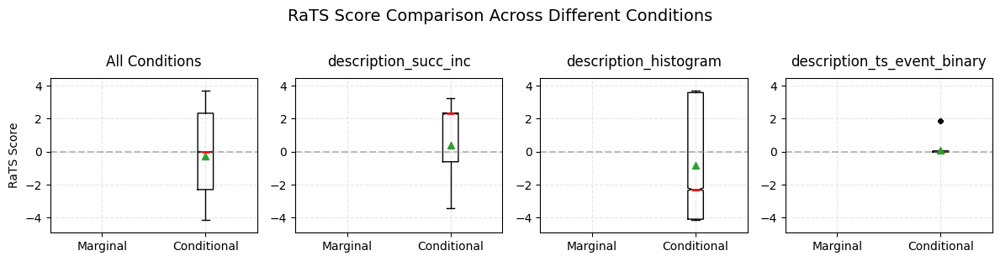

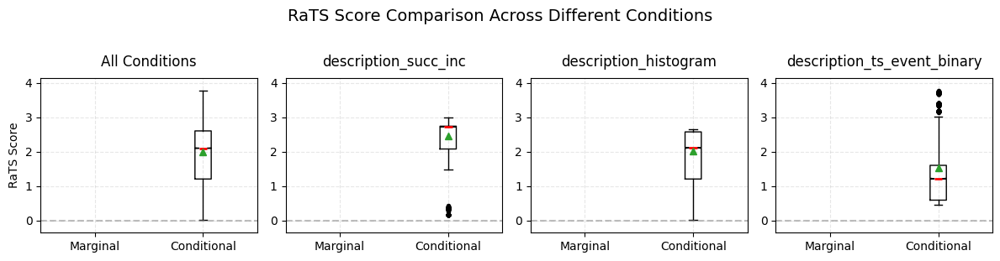

In [7]:
w = 0.8
with open('run/eval.py', 'r') as file:
    exec(file.read())
with open('run/eng_eval.py', 'r') as file:
    exec(file.read())


In [8]:
summarize_scores(df_all)

metric,DTW distance decrease ↓,LCSS similarity increase ↑,RaTS ↑,|RaTS (preserved)|↓
final_score,-4.28 (7.62),0.09 (0.23),-0.29 (2.62),2.00 (0.81)


In [9]:
summarize_scores(df_all, mean_sd = False)

metric,DTW distance decrease ↓,LCSS similarity increase ↑,RaTS ↑,|RaTS (preserved)|↓
final_score,"-2.97 [-5.22, -1.13]","0.04 [0.01, 0.13]","-0.02 [-2.30, 2.33]","2.10 [1.20, 2.60]"


description_succ_inc


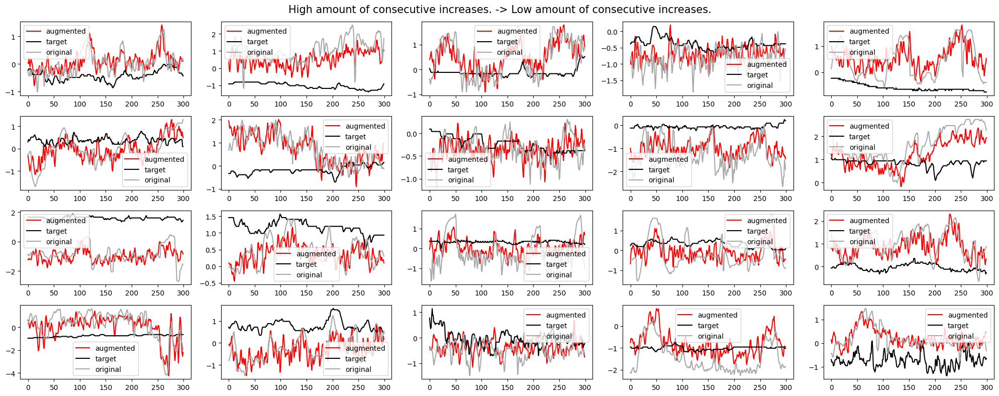

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2206.25it/s]


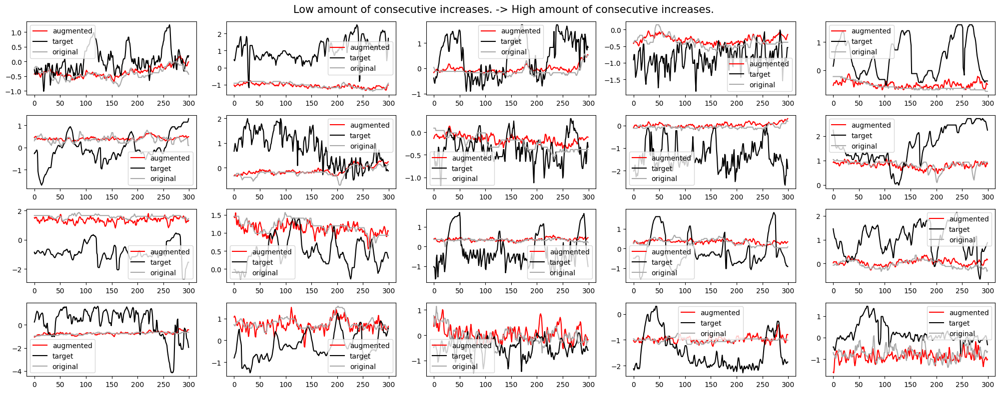

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2235.89it/s]


description_histogram


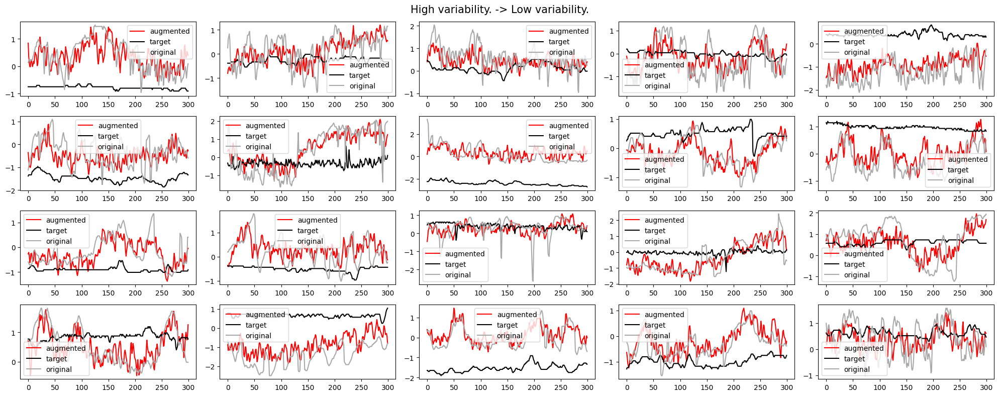

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2303.69it/s]


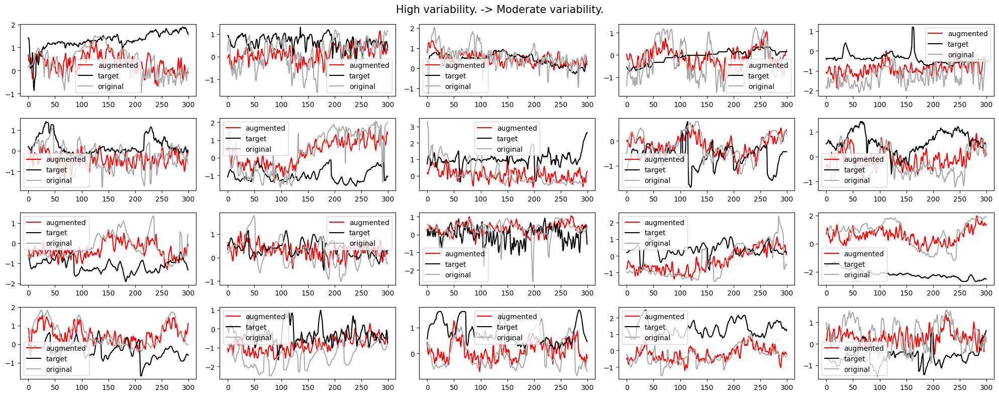

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2196.35it/s]


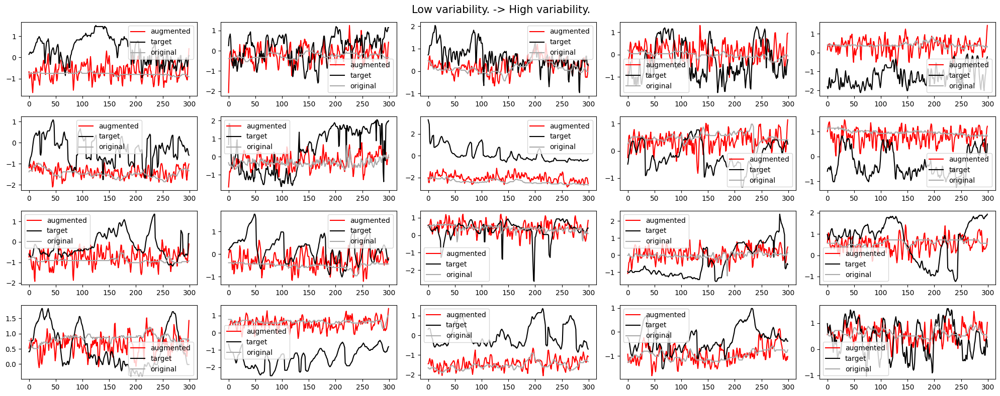

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2180.84it/s]


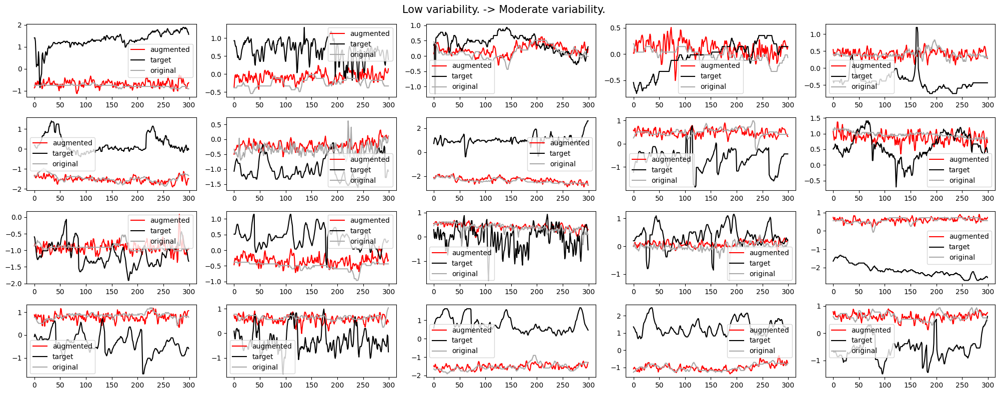

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2206.55it/s]


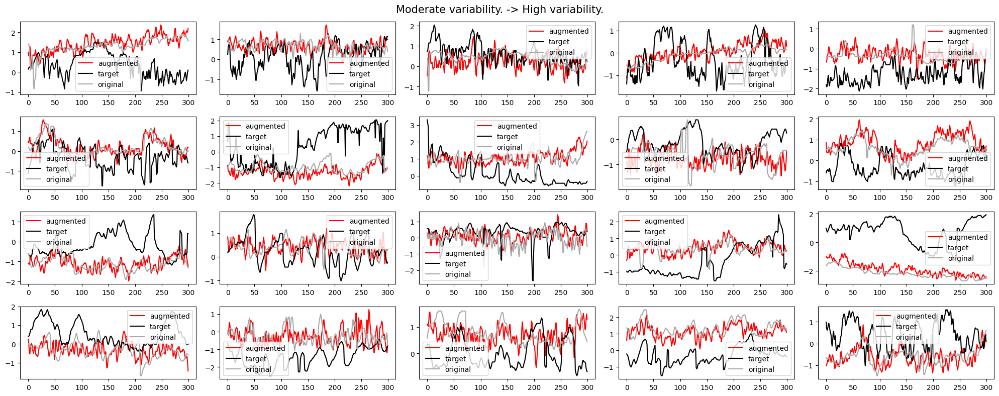

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2312.03it/s]


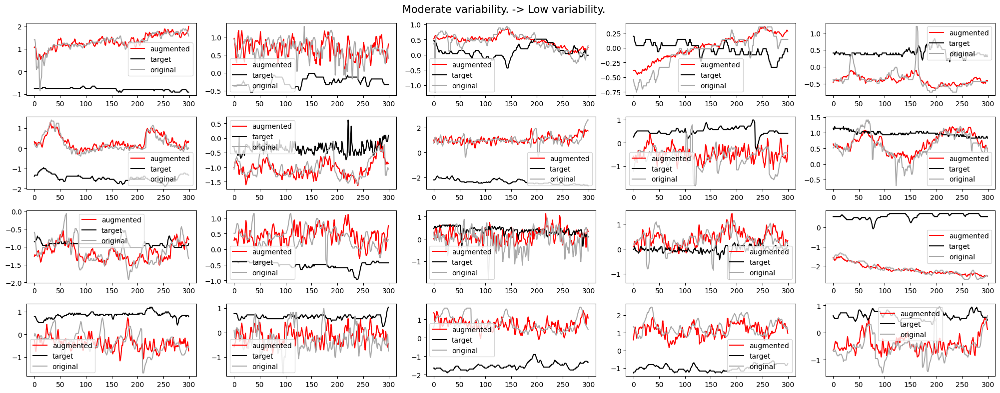

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2133.63it/s]


description_ts_event_binary


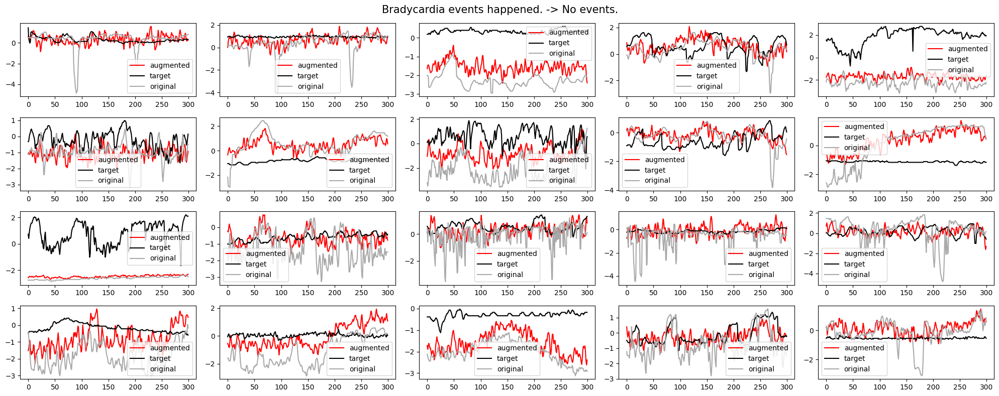

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2198.43it/s]


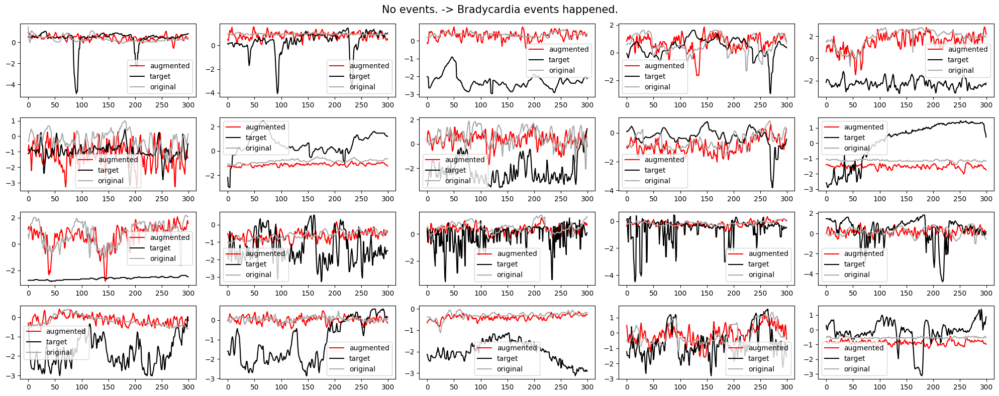

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2265.70it/s]


description_succ_inc


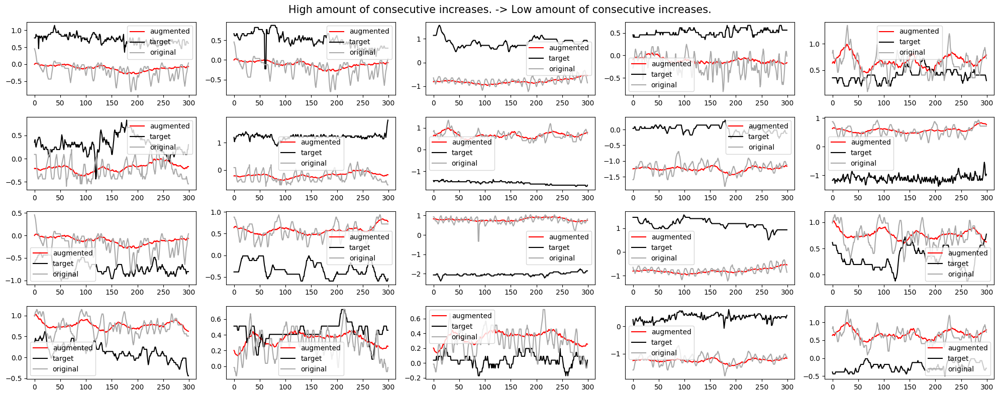

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2303.81it/s]


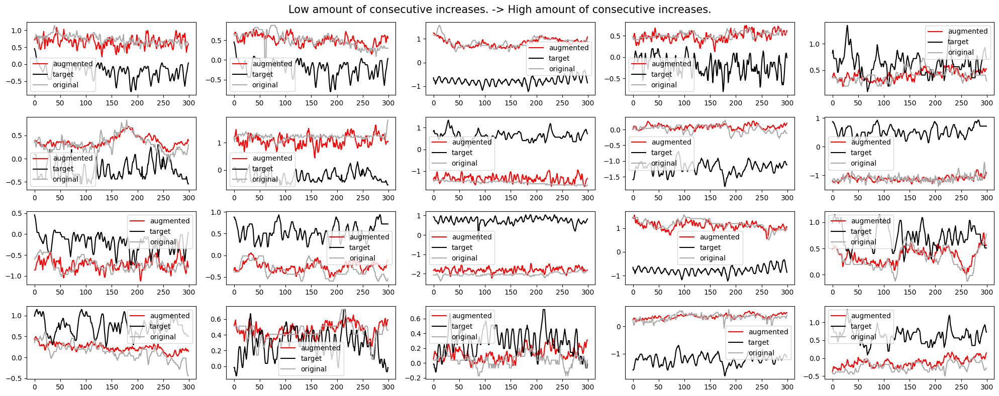

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2126.70it/s]


description_histogram


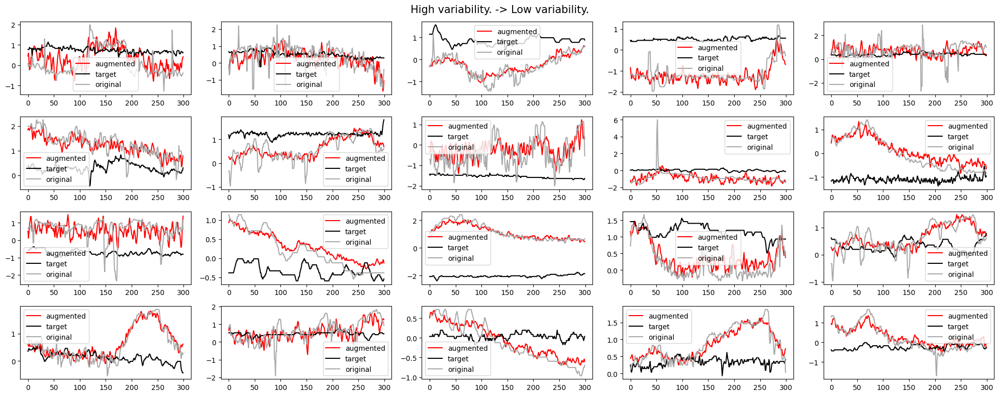

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2183.28it/s]


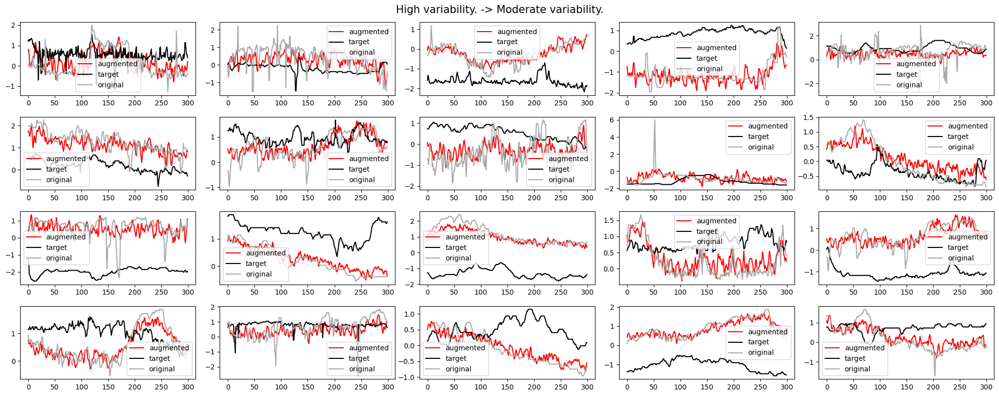

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2194.64it/s]


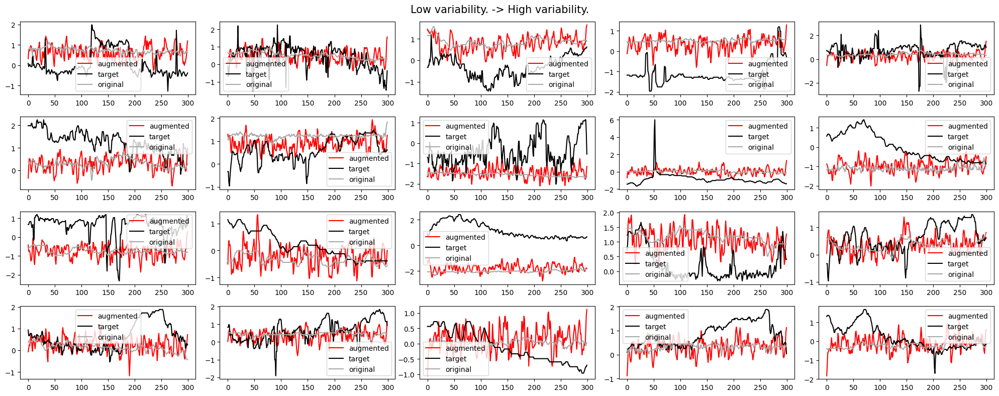

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2242.06it/s]


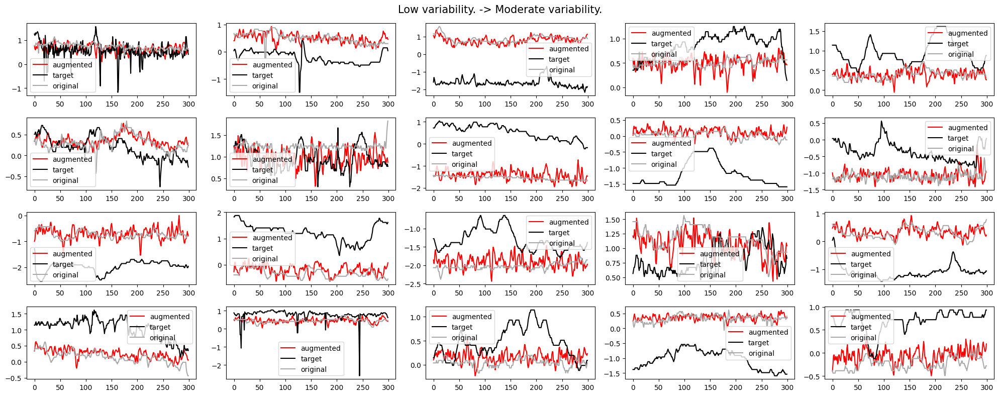

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2274.31it/s]


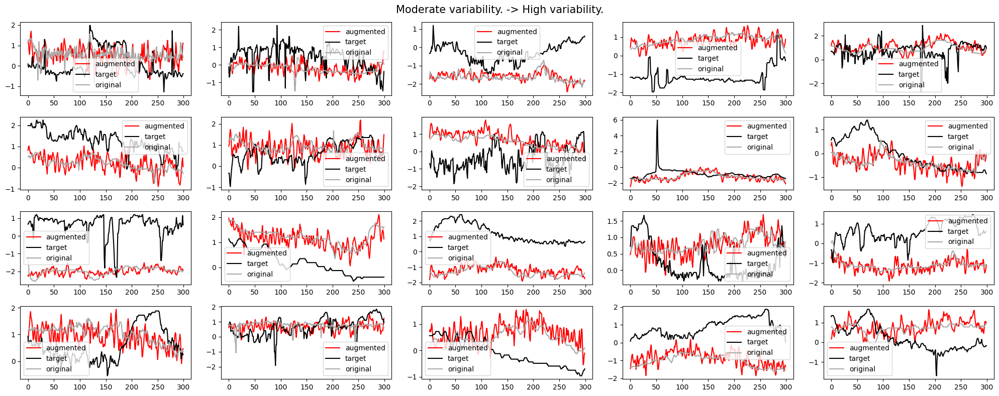

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2300.59it/s]


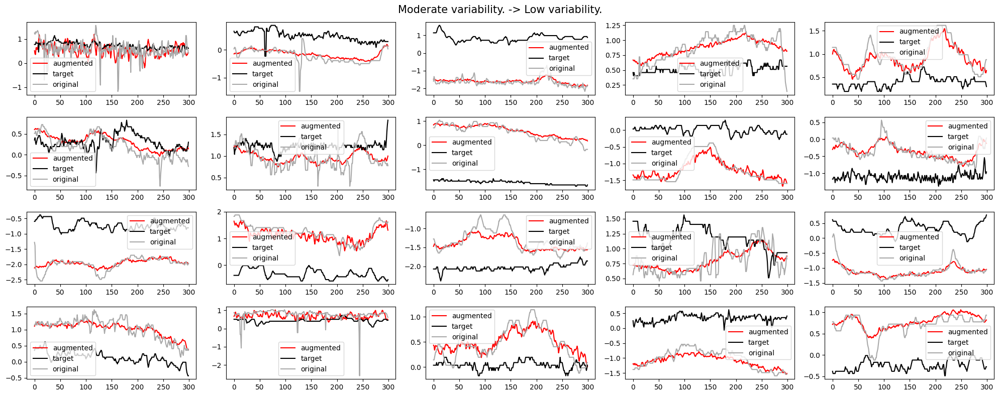

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2250.77it/s]


description_ts_event_binary


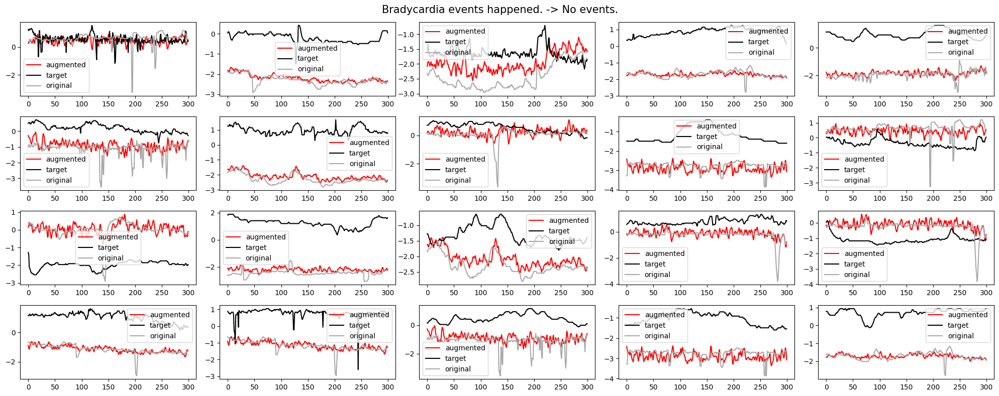

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2211.58it/s]


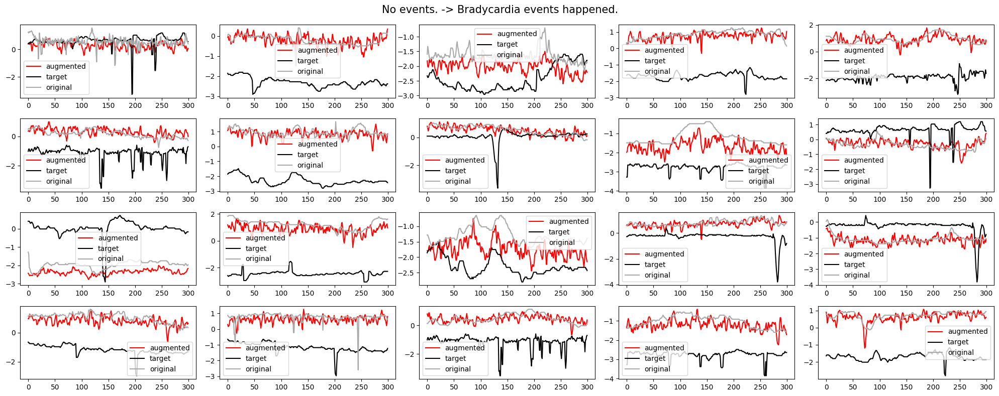

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2296.88it/s]


Early stopping at epoch 357


Early stopping at epoch 495


Early stopping at epoch 323


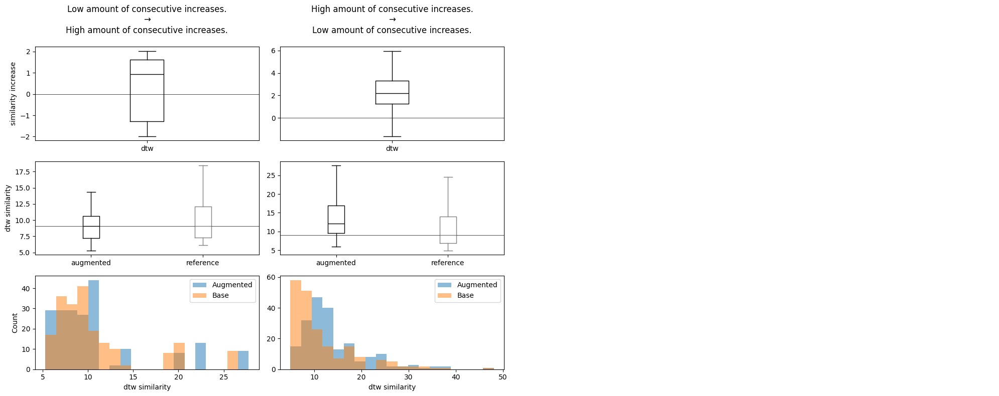

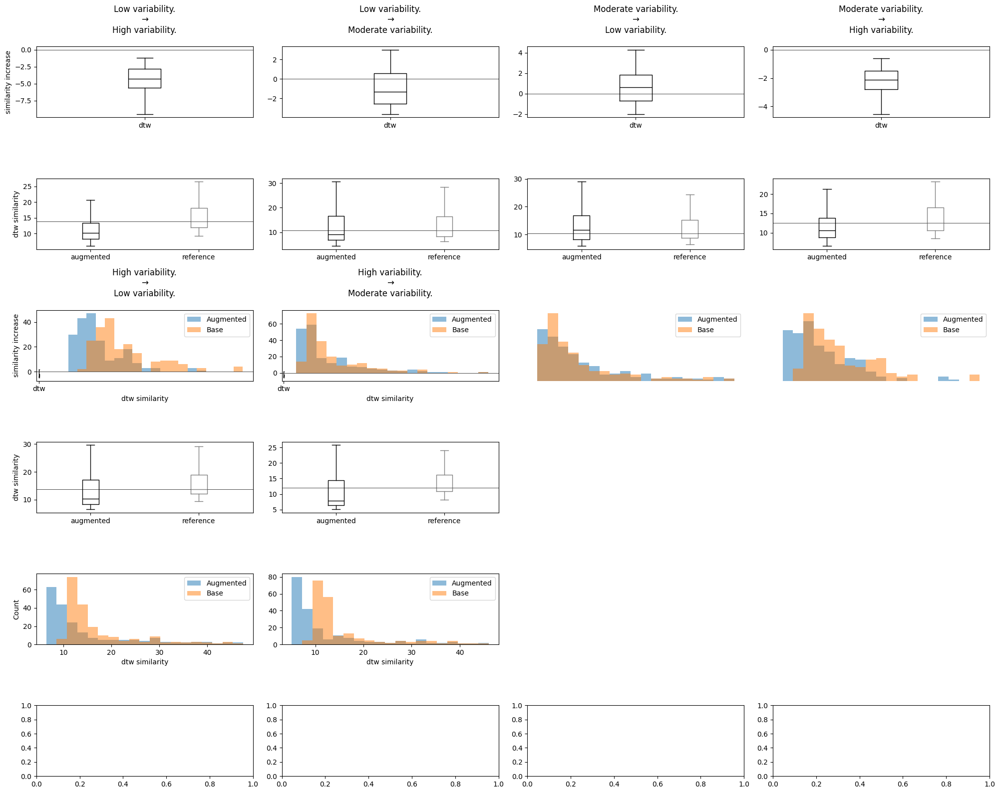

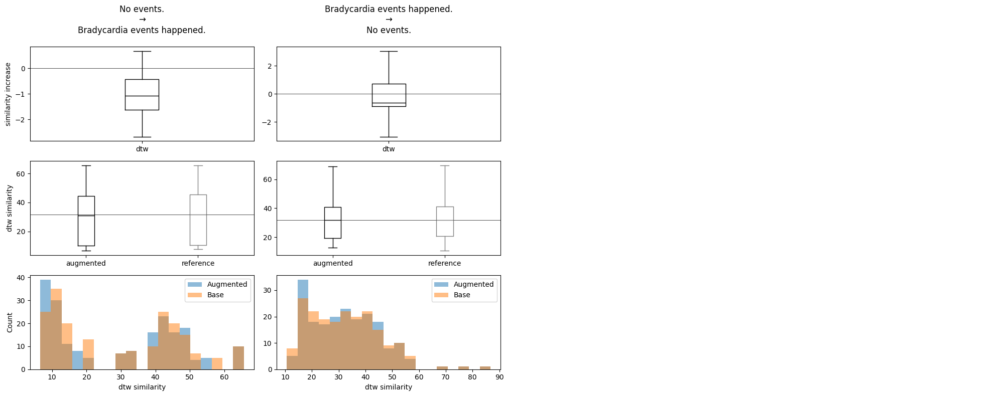

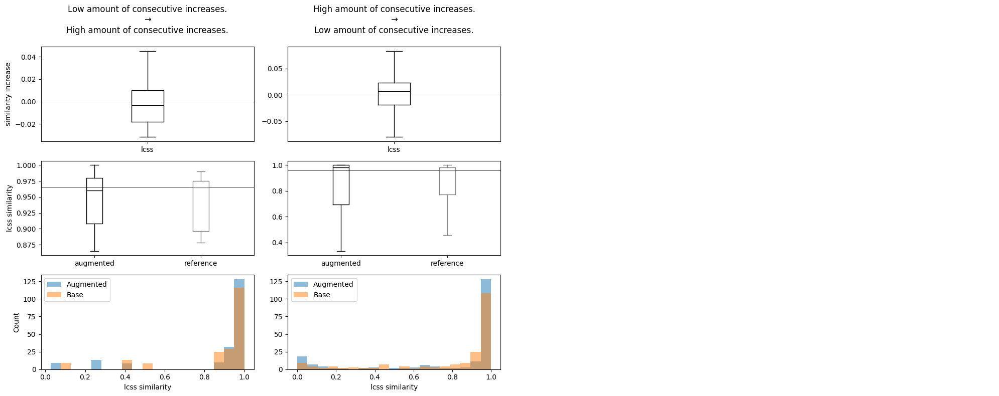

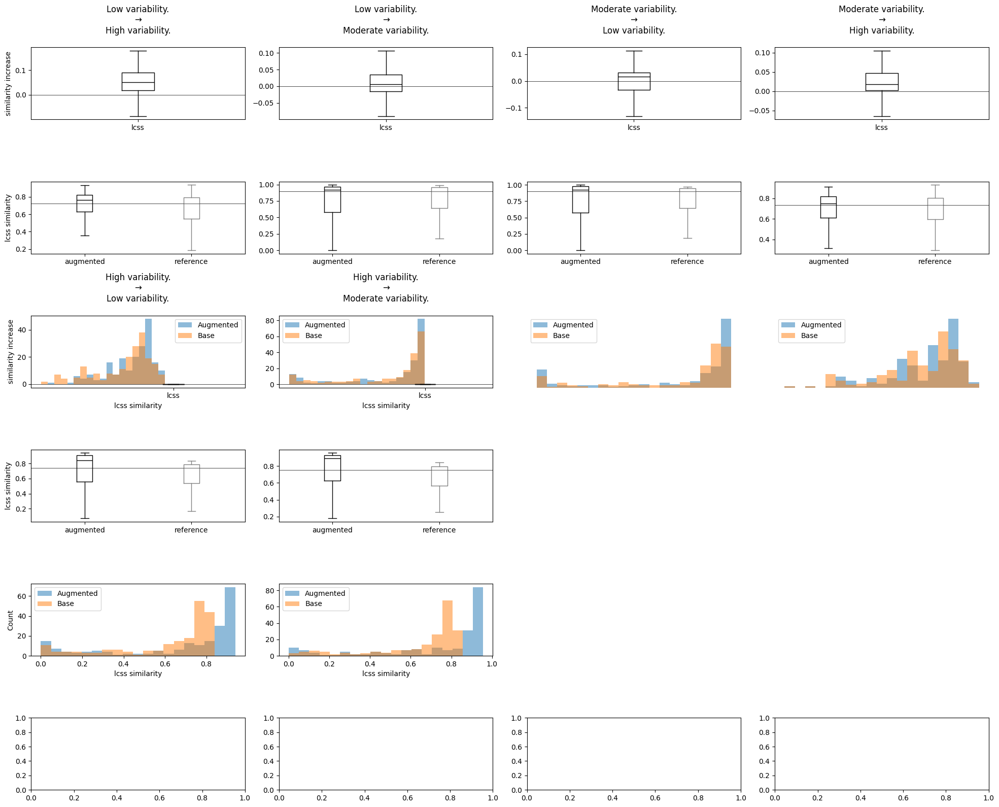

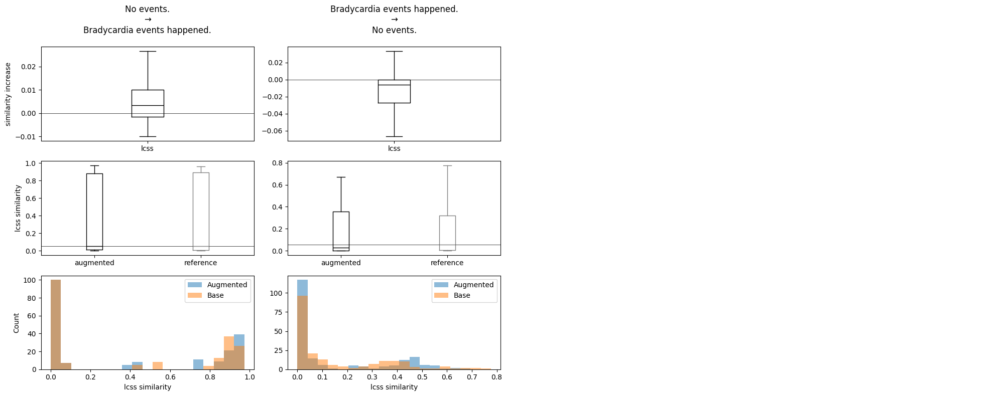

--------------------------------------------------------------------------------


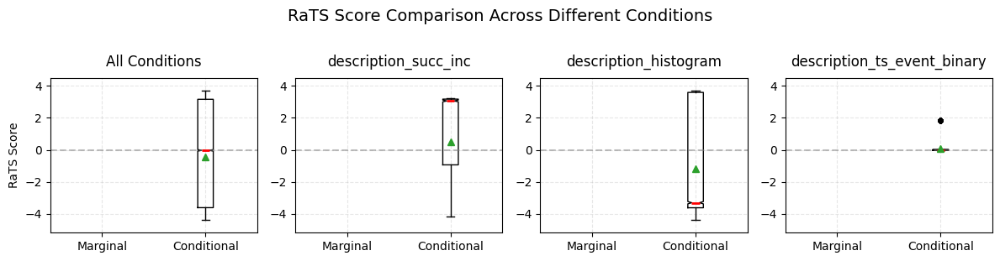

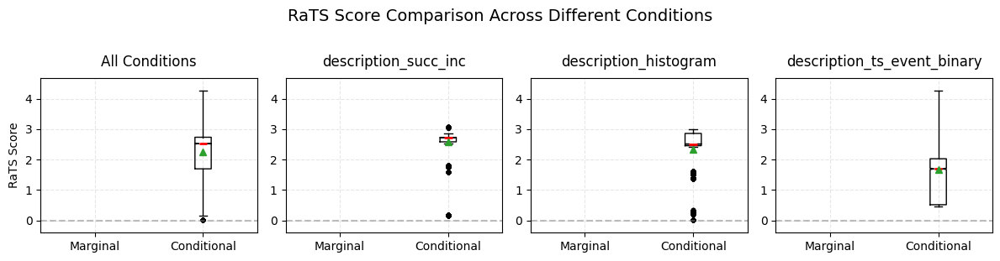

In [4]:
w = 0.6
with open('run/eval.py', 'r') as file:
    exec(file.read())
with open('run/eng_eval.py', 'r') as file:
    exec(file.read())


In [5]:
summarize_scores(df_all)

metric,DTW distance decrease ↓,LCSS similarity increase ↑,RaTS ↑,|RaTS (preserved)|↓
final_score,-1.14 (2.49),0.02 (0.07),-0.43 (2.92),2.24 (0.81)


In [6]:
summarize_scores(df_all, mean_sd = False)

metric,DTW distance decrease ↓,LCSS similarity increase ↑,RaTS ↑,|RaTS (preserved)|↓
final_score,"-1.21 [-2.76, 0.68]","0.01 [-0.01, 0.06]","-0.03 [-3.60, 3.16]","2.52 [1.69, 2.73]"
